<!-- group no.8 -->

# Preparations

In [1]:
import os, sys
import random
import warnings

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

#For the plots
%matplotlib inline
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
warnings.filterwarnings('ignore')
plt.style.use('ggplot')

set random Seed

In [2]:
random_state = 42
# np.random.seed = random_state
rng = np.random.default_rng(random_state)

get some **DATA!**

In [3]:
train = pd.read_csv('../data/processed/train.csv')
train.drop(['id'], inplace=True, axis=1)

test = pd.read_csv('../data/processed/test.csv')
test.drop(['id'], inplace=True, axis=1)

In [4]:
train['isTrain'] = True
test['isTrain'] = False

test_train = pd.concat([train, test]).reset_index(drop=True).copy()
train.drop(['isTrain'], inplace=True, axis=1)
test.drop(['isTrain'], inplace=True, axis=1)
test_train.tail()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity,isTrain
49995,196204.0,0.083936,0.823252,0.442246,0.002990,1.0,0.123921,-8.682195,1,0.041171,98.264618,4,0.784104,NaN,False
49996,218343.0,0.105279,0.683743,0.848627,0.001911,6.0,0.106522,-4.946250,0,0.033605,103.949646,4,0.850754,NaN,False
49997,188434.0,0.753472,0.783947,0.498261,0.134027,6.0,0.088147,-11.812606,1,0.029526,119.090558,4,0.482961,NaN,False
49998,173044.0,0.863579,0.373283,0.476142,0.000049,10.0,0.122122,-12.371232,0,0.190628,103.048349,3,0.518742,NaN,False
49999,157896.0,0.019852,0.720380,NaN,0.037727,2.0,0.139422,-4.965311,1,0.053257,109.873611,4,0.971368,NaN,False


In [7]:
col_y = 'song_popularity'

X = train.copy()
y = X.pop(col_y)

target_variable = y.name

# get all column names except song_popularity
FEATURES = [c for c in X.columns.tolist() if c != col_y]
FEATURES

['song_duration_ms',
 'acousticness',
 'danceability',
 'energy',
 'instrumentalness',
 'key',
 'liveness',
 'loudness',
 'audio_mode',
 'speechiness',
 'tempo',
 'time_signature',
 'audio_valence']

split the data but retain the target distribution

In [8]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=random_state, stratify=y)
train.shape, test.shape, test_train.shape

((40000, 14), (10000, 13), (50000, 15))

# Overview: Structure and Data Content

### Data descrption

Source - Spotify: "In Spotify's API is something called Valence, that describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (happy, cheerful, euphoric), while tracks with low valence sound more negative (sad, depressed, angry)."

[**From very good article explaining Spotify API What Makes a Song Likeable**?](https://towardsdatascience.com/what-makes-a-song-likeable-dbfdb7abe404)- we can read that:

---

Spotify Audio Features
For every track on their platform, Spotify provides data for thirteen Audio Features.The Spotify Web API developer guide defines them as follows:

* **Danceability:** Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.

* **Valence**: Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).

* **Energy**: Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.

* **Tempo**: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.

* **Loudness**: The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks.

* **Speechiness**: This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.
Instrumentalness: Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”.

* **Liveness**: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.

* **Acousticness**: A confidence measure from 0.0 to 1.0 of whether the track is acoustic.

* **Key**: The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.

* **Mode**: Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.

* **Duration**: The duration of the track in milliseconds.

* **Time Signature**: An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).

Data Provided by Remek Kinas [SOURCE](https://www.kaggle.com/c/song-popularity-prediction/discussion/301616)

---

Resources for EDA:
* [Song Popularity Prediction EDA with Martin Henze (Heads or Tails)](https://www.youtube.com/watch?v=JXF-7rCcR1c)
* [Song Popularity Prediction: EDA with Martin Henze (Part-2)](https://www.youtube.com/watch?v=2aE6SvCVOis&ab_channel=AbhishekThakur)
* [Song Popularity EDA - Live Coding Fun - Martin Notebook](https://www.kaggle.com/headsortails/song-popularity-eda-live-coding-fun)

## Look at the Data

In [9]:
# check top 5 samples/records
train.head()

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
0,212990.0,0.642286,0.856520,0.707073,0.002001,10.0,NaN,-5.619088,0,0.082570,158.386236,4,0.734642,0
1,NaN,0.054866,0.733289,0.835545,0.000996,8.0,0.436428,-5.236965,1,0.127358,102.752988,3,0.711531,1
2,193213.0,NaN,0.188387,0.783524,-0.002694,5.0,0.170499,-4.951759,0,0.052282,178.685791,3,0.425536,0
3,249893.0,0.488660,0.585234,0.552685,0.000608,0.0,0.094805,-7.893694,0,0.035618,128.715630,3,0.453597,0
4,165969.0,0.493017,NaN,0.740982,0.002033,10.0,0.094891,-2.684095,0,0.050746,121.928157,4,0.741311,0


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   song_duration_ms  35899 non-null  float64
 1   acousticness      36008 non-null  float64
 2   danceability      35974 non-null  float64
 3   energy            36025 non-null  float64
 4   instrumentalness  36015 non-null  float64
 5   key               35935 non-null  float64
 6   liveness          35914 non-null  float64
 7   loudness          36043 non-null  float64
 8   audio_mode        40000 non-null  int64  
 9   speechiness       40000 non-null  float64
 10  tempo             40000 non-null  float64
 11  time_signature    40000 non-null  int64  
 12  audio_valence     40000 non-null  float64
 13  song_popularity   40000 non-null  int64  
dtypes: float64(11), int64(3)
memory usage: 4.3 MB


In [11]:
# statastical description of dataset
print("unique values in each column of dataset: \n")
print(train.apply(lambda x: x.nunique()))
print("\nDataset Description: \n")
train.describe().T[:-1].to_csv('../reports/tables/numerical-descriptive-stats.csv')
train.describe().T[:-1]

unique values in each column of dataset: 

song_duration_ms    31586
acousticness        36004
danceability        35972
energy              36021
instrumentalness    35999
key                    12
liveness            35911
loudness            36038
audio_mode              2
speechiness         39999
tempo               39993
time_signature          4
audio_valence       39998
song_popularity         2
dtype: int64

Dataset Description: 



,count,mean,std,min,25%,50%,75%,max
song_duration_ms,35899.0,193165.847572,45822.127679,25658.000000,166254.500000,186660.000000,215116.000000,491671.000000
acousticness,36008.0,0.276404,0.297928,-0.013551,0.039618,0.140532,0.482499,1.065284
danceability,35974.0,0.570951,0.190010,0.043961,0.424760,0.608234,0.718464,0.957131
energy,36025.0,0.683932,0.212662,-0.001682,0.539276,0.704453,0.870503,1.039741
instrumentalness,36015.0,0.036527,0.150024,-0.004398,0.000941,0.001974,0.003225,1.075415
key,35935.0,5.042605,3.372728,0.000000,2.000000,5.000000,8.000000,11.000000
liveness,35914.0,0.198514,0.151670,0.027843,0.111796,0.135945,0.212842,1.065298
loudness,36043.0,-7.407596,3.877198,-32.117911,-9.578139,-6.345413,-4.620711,-0.877346
audio_mode,40000.0,0.321150,0.466924,0.000000,0.000000,0.000000,1.000000,1.000000
speechiness,40000.0,0.094107,0.083591,0.015065,0.038500,0.055881,0.118842,0.560748


We find:

* The average song duration is 193 seconds or about 3 minutes having standard deviation of 45 seconds. Simarly average Tempo of a perticular song is 116 with std of 26.

* There are a number of features with values between approximately 0 and 1; such as acousticness, danceability, or liveness among others.
    
* All of loudness values are negative. audio_mode seems even more of a binary feature, and time_signature and key even more of categoricals.

### Missing values

In [12]:
# % of missing values records
print(f"%{100*test_train.isnull().any(axis=1).sum()/test_train.shape[0]} of records have missing values.")

%65.482 of records have missing values.


In [13]:
# % of missing values records
na_val_density = 100*test_train.isnull().sum(axis=1).sum()/(test_train.shape[0]*test_train.shape[1])
print(f"but the density of na values is only %{np.round(na_val_density, 3)}. Meaning, our dataset isn't empty of information.")

but the density of na values is only %6.687. Meaning, our dataset isn't empty of information.


In [14]:
mask = X.nunique() < 15
categorical_cols = X.columns[mask].tolist()
numerical_cols = [col for col in FEATURES if col not in categorical_cols]
print("Categorical columns: \n")
print(categorical_cols)
print("\nNumerical columns: \n")
print(numerical_cols)

Categorical columns: 

['key', 'audio_mode', 'time_signature']

Numerical columns: 

['song_duration_ms', 'acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'audio_valence']


possible reason for these `NaN`s might be disfunctional recording instruments.

In [15]:
nans_train = train.isnull().sum().sort_values(ascending=False)
nans_test = test.isnull().sum().sort_values(ascending=False)
nans_train = nans_train[nans_train > 0]
nans_test = nans_test[nans_test > 0]
features_with_nans = nans_train.index.values

percent_nans_train = round((nans_train/train.shape[0]), ndigits=4)
percent_nans_test = round((nans_test/test.shape[0]), ndigits=4)
print(f"missing values in train: \t\t\t\t", end='')
print(f"And test: \n")
for i in range(len(percent_nans_train)):
  print('{:18}: {:} ({:}% of train) \t,\t {:} ({:}% of test).'.format(features_with_nans[i], nans_train[i], np.round(100*percent_nans_train[i], 3), nans_test[i], np.round(100*percent_nans_test[i], 3)))

missing values in train: 				And test: 

song_duration_ms  : 4101 (10.25% of train) 	,	 1055 (10.55% of test).
liveness          : 4086 (10.22% of train) 	,	 1026 (10.26% of test).
key               : 4065 (10.16% of train) 	,	 1006 (10.06% of test).
danceability      : 4026 (10.06% of train) 	,	 1000 (10.0% of test).
acousticness      : 3992 (9.98% of train) 	,	 992 (9.92% of test).
instrumentalness  : 3985 (9.96% of train) 	,	 976 (9.76% of test).
energy            : 3975 (9.94% of train) 	,	 957 (9.57% of test).
loudness          : 3957 (9.89% of train) 	,	 950 (9.5% of test).


There are 8 columns with significant amount of missing values which cannot be ignored nor removed.

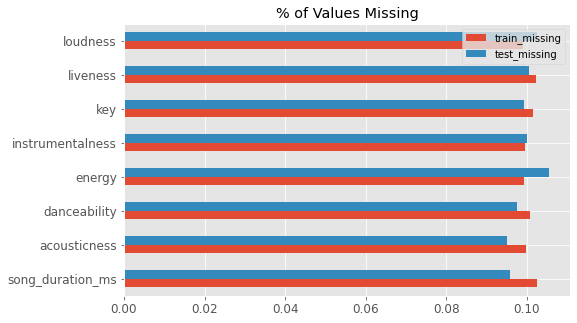

In [17]:
ncounts = pd.DataFrame([train.isna().mean(), test.isna().mean()]).T
ncounts = ncounts.rename(columns={0: "train_missing", 1: "test_missing"})
# get indice names of ncounts
nacols = ncounts.query("train_missing > 0").index.values.tolist()
nacols

ncounts.query("train_missing > 0").plot(
    kind="barh", figsize=(8, 5), title="% of Values Missing"
)
plt.savefig('../reports/figures/percentage_missing_values_in_each_col.png')
plt.show()

### How many missing values per observation?

In [18]:
test_train["n_missing"] = test_train[nacols].isna().sum(axis=1)
train["n_missing"] = train[nacols].isna().sum(axis=1)
test["n_missing"] = test[nacols].isna().sum(axis=1)

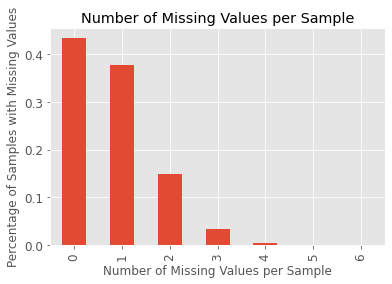

In [19]:
(test_train["n_missing"].value_counts()/test_train.shape[0]).plot(
    kind="bar", title="Number of Missing Values per Sample"
)
plt.savefig('../reports/figures/percentage_missing_values_in_row.png')
plt.xlabel("Number of Missing Values per Sample")
plt.ylabel("Percentage of Samples with Missing Values")
plt.show()

There appears to be about 43% of records which are completely clean. This is a significantly low number suggesting that more than 57% or samples have missing values in them. Apart from that, 38% of instances have at most 1 missing feature, followed by 2 exact missing features comprising 15% of records. And lastly, less than 5% of records have more than 2 missing values but, the at most only 3 records have highest amount of column missing information but only six six features were missing from them.

Do we see an imbalance in missing values when splitting by other features?

while we'r at it let's also check target imbalance

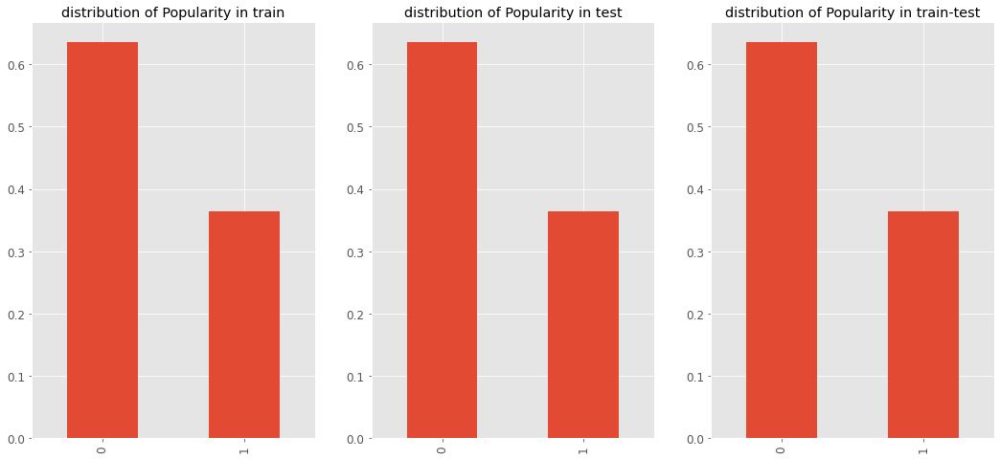

In [20]:
# target distribution in percentage
_, axs = plt.subplots(1, 3, figsize=(18, 8))
y_train.value_counts(normalize=True).plot(kind="bar", title="distribution of Popularity in train", ax=axs[0])
y_test.value_counts(normalize=True).plot(kind="bar", title="distribution of Popularity in test", ax=axs[1])
train[col_y].value_counts(normalize=True).plot(kind="bar", title="distribution of Popularity in train-test", ax=axs[2])
plt.savefig('../reports/figures/target_distribution.png')
plt.show()

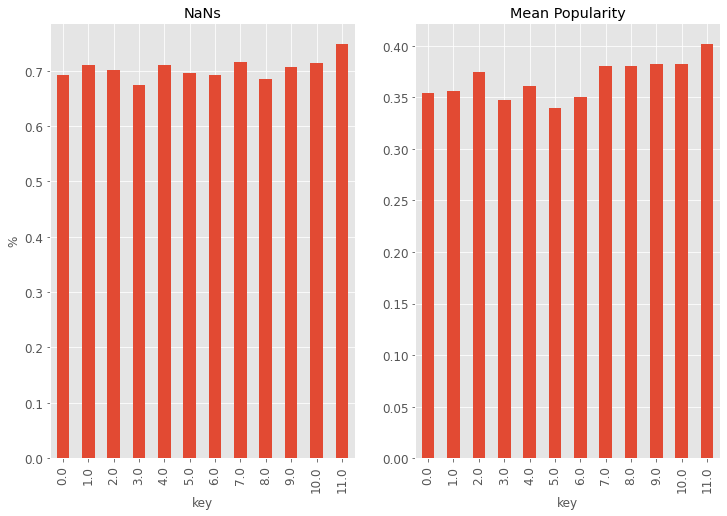

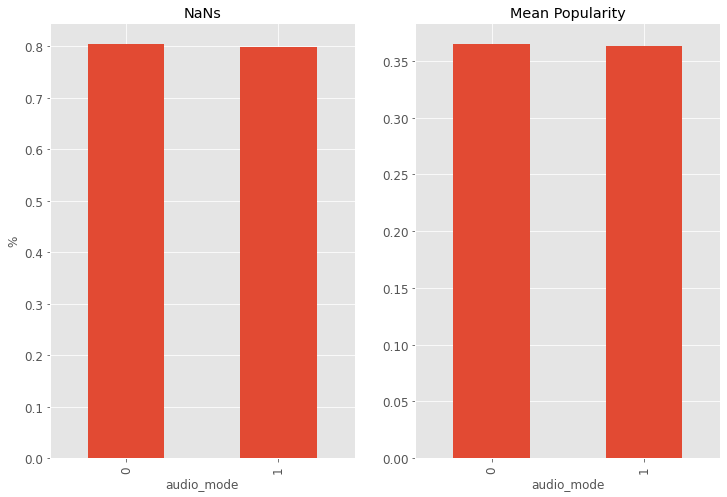

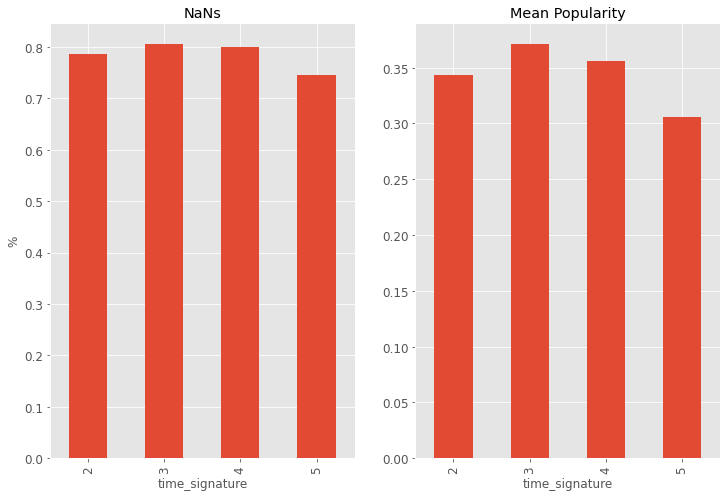

In [21]:
for col in categorical_cols:
    _, axs = plt.subplots(1, 2, figsize=(12, 8))
    test_train.groupby(col)["n_missing"].mean().plot(kind="bar", ax=axs[0], ylabel="%", title='NaNs')
    test_train.groupby(col)[col_y].mean().plot(kind="bar", ax=axs[1], title='Mean Popularity')
    plt.savefig('../reports/figures/missing_values_in_each_levels_of_' + col + '.png')
    plt.show()

We find that:

* Not all features have missing values, though. We find them only in the first 8 columns (not counting the id). Consequently, those columns have around 10% missing values.

* There are some slight differences in the train vs test percentages of missing values for most features.

* overall there's more than 35% of records which has at least 1 missing feature

* there isn't much imbalance in missing values when splitting by features

## Feature transformations

In [22]:
# convert audio_mode, key & time_signature column values to categorical
X_train[categorical_cols] = train[categorical_cols].astype('category')
# get levels of categorical columns
X_train[categorical_cols].apply(lambda x: x.cat.categories)

key               Float64Index([0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6....
audio_mode                        Int64Index([0, 1], dtype='int64')
time_signature              Int64Index([2, 3, 4, 5], dtype='int64')
dtype: object

In [23]:
# convert the train dataset info into Dataframe & export it to csv

description = [
  "The duration of the track in milliseconds.",

  "A confidence measure from 0.0 to 1.0 of whether the track is acoustic.",

  "Describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity.",

  "Represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale.",

  'Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal".',

  "The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.",

  "Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.",

  "The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks.",

  "Indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.",

  "This detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value.",

  "The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece, and derives directly from the average beat duration.",

  "An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).",

  "Describes the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).",

  "Whether the song is popular or not."
]

for i, col in enumerate(train.columns[:-1]):
  if train[col].dtype in ['category', 'int64']:
    description[i] += f"\nn_levels: {train[col].nunique()}"

dataset_description = pd.DataFrame(data={"Column": train.columns.to_list()[:-1],
                    "data type" : train.dtypes.to_list()[:-1],
                    "description" : description
                    }).reset_index(drop=True)
                    
dataset_description.to_csv('../reports/tables/data-dict.csv', index=False)
dataset_description

,Column,data type,description
0,song_duration_ms,float64,The duration of the track in milliseconds.
1,acousticness,float64,A confidence measure from 0.0 to 1.0 of whethe...
2,danceability,float64,Describes how suitable a track is for dancing ...
3,energy,float64,Represents a perceptual measure of intensity a...
4,instrumentalness,float64,"Predicts whether a track contains no vocals. ""..."
5,key,float64,The estimated overall key of the track. Intege...
6,liveness,float64,Detects the presence of an audience in the rec...
7,loudness,float64,The overall loudness of a track in decibels (d...
8,audio_mode,int64,Indicates the modality (major or minor) of a t...
9,speechiness,float64,This detects the presence of spoken words in a...


hypothesis: we can try to predict the target using only missing value indicators as features, to get some information out of missing values only(make sense?)

In [24]:
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import roc_auc_score

lr = LogisticRegressionCV(scoring="accuracy")

X_na = X_train[nacols].isna()
y_na = y_train

lr.fit(X_na, y_na)
lr.score(X_na, y_na)

preds = lr.predict_proba(X_na)[:, 0]

print(f"roc_auc_score of a logistic regression model on only null value labels is: {roc_auc_score(y_na, preds)}")

roc_auc_score of a logistic regression model on only null value labels is: 0.49281499187350847


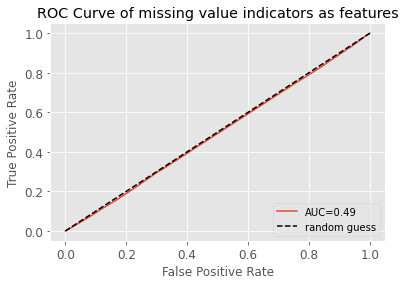

In [25]:
# plot auc-roc curve
from sklearn.metrics import roc_curve

fpr, tpr, thresholds = roc_curve(y_na, preds)
auc = roc_auc_score(y_na, preds)

plt.plot(fpr, tpr, label="AUC=%0.2f" % auc)
plt.plot([0, 1], [0, 1], "k--", label="random guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve of missing value indicators as features")
plt.legend(loc="lower right")
plt.savefig('../reports/figures/roc_curve of missing value indicators as features.png')
plt.show()

Well, our hypothesis fails. Suggesting that we can't get any possible insights that would benefit in modeling.

## Data visualization 

### Baby steps - Individual Features

Things to take into consideration:
* different scales
* missing values
* log transformations needed for skewed

Candidates for transformations: spechiness, tempo, loudness, acoustiness, liveness, energry, danceability?

Normal ditibuted: song_duration



#### Discrete variables plots

In [26]:
#Checking out unique values in discrete variables
num_categorical = ['audio_mode', 'time_signature', 'key']
for i in num_categorical:
  print(f"{i}, {train[i].unique()} length: {len(train[i].unique())}")

audio_mode, [0 1] length: 2
time_signature, [4 3 2 5] length: 4
key, [10.  8.  5.  0.  4.  3. nan  6.  2.  7.  1.  9. 11.] length: 13


In [27]:
X_train_full = pd.concat([X_train, y_train], axis=1)
X_train_full

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,song_popularity
8445,249165.0,0.018023,0.691292,NaN,0.002070,7.0,0.253386,NaN,0,0.133197,119.674313,4,0.291141,0
29445,262839.0,0.029204,0.296050,0.747173,0.000863,0.0,0.146838,-10.175356,1,0.331771,97.095876,4,0.476756,1
27510,249180.0,NaN,0.240227,0.981282,0.003295,6.0,0.111339,NaN,0,0.095754,121.685407,3,0.226383,0
21464,150192.0,0.896027,0.290141,0.260367,0.004380,10.0,0.210436,-12.902434,0,0.039707,122.609402,3,0.436087,1
1915,169956.0,0.606447,0.784803,NaN,0.000923,4.0,0.353536,-7.492491,0,0.043732,79.920547,3,0.343077,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14936,90620.0,0.967651,0.253237,0.398236,0.003823,2.0,0.213360,-23.354092,0,0.031386,82.601872,3,0.422895,0
14703,211823.0,0.583792,0.720222,0.628030,0.003093,4.0,0.133730,-12.502398,0,0.033433,166.185831,3,0.612711,0
39473,NaN,0.274205,0.782401,NaN,0.001922,9.0,0.410477,-4.885842,0,0.055442,149.771691,3,0.679638,0
23595,283988.0,0.057312,0.365561,0.995350,0.001700,7.0,0.598332,NaN,0,0.280034,170.334846,3,0.635851,0


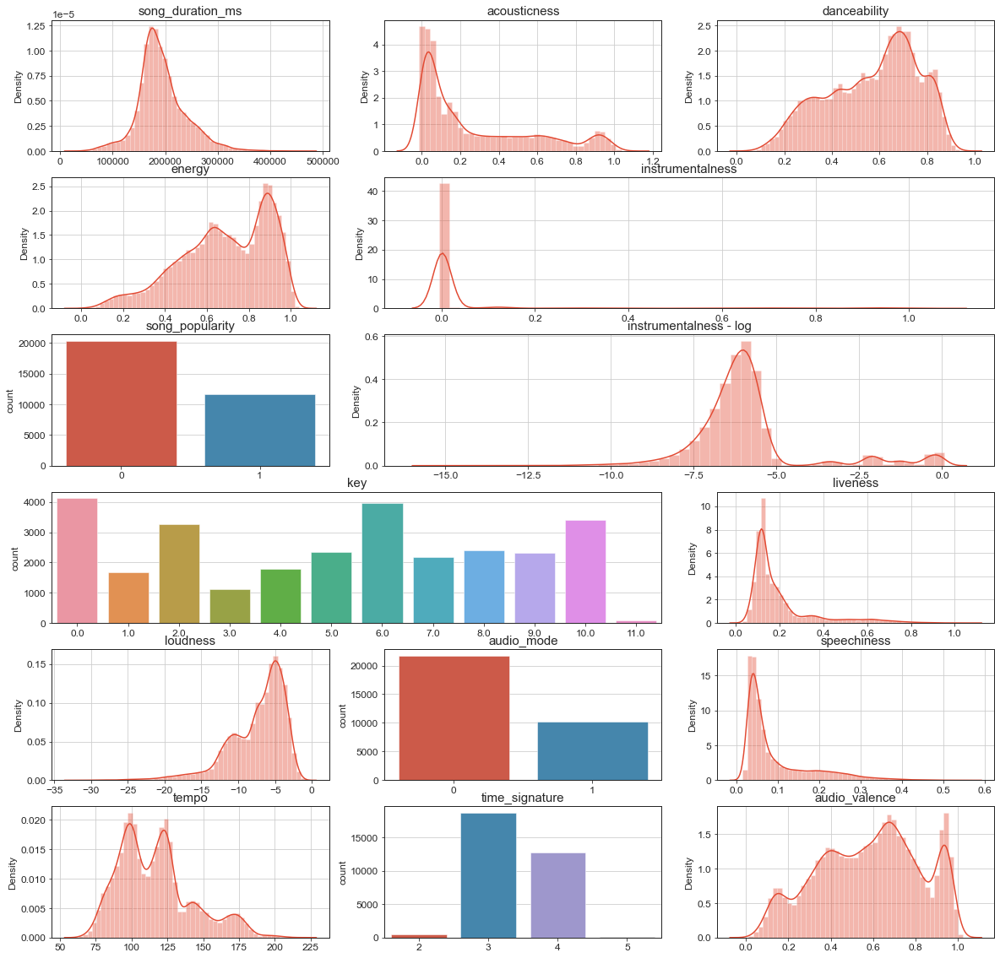

In [28]:
sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,20))

axes = [plt.subplot2grid((6, 3), (0, 0)),
        plt.subplot2grid((6, 3), (0, 1)),
        plt.subplot2grid((6, 3), (0, 2)),
        plt.subplot2grid((6, 3), (1, 0)),
        plt.subplot2grid((6, 3), (1, 1), colspan=2),
        plt.subplot2grid((6, 3), (2, 0)),
        plt.subplot2grid((6, 3), (2, 1), colspan=2),
        plt.subplot2grid((6, 3), (3, 0), colspan=2),
        plt.subplot2grid((6, 3), (3, 2)),
        plt.subplot2grid((6, 3), (4, 0)),
        plt.subplot2grid((6, 3), (4, 1)),
        plt.subplot2grid((6, 3), (4, 2)),
        plt.subplot2grid((6, 3), (5, 0)),
        plt.subplot2grid((6, 3), (5, 1)),
        plt.subplot2grid((6, 3), (5, 2))]

plots = X_train_full.columns.to_list()[:-1]
plots.insert(5, y_train.name)
plots.insert(6, 'instrumentalness - log')
for i, variable in enumerate(plots):
    if variable == 'instrumentalness - log':
        sns.distplot(np.log(X_train_full['instrumentalness']), ax=axes[i], kde=True)
    elif variable not in numerical_cols:
        sns.countplot(x=variable, data=X_train_full, ax=axes[i])
    else:
        sns.distplot(X_train_full[variable], ax=axes[i], kde=True)
    axes[i].set_title(variable, fontsize=15)
    axes[i].set_xlabel('')

plt.savefig(f'../reports/figures/distributions.png', bbox_inches='tight')
plt.show()

In [33]:
X_train_full['instrumentalness - log'] = np.log(X_train_full['instrumentalness'])

we can see that:

- out of all features, `song_duration_ms` appears to more closely to gausian distribution then other features.

- `acousticness`, `liveness`, `speechieness` are showing skewness towards right side and, `loudness` and `energy` has left skewed distribution. **To correct this skewness we can apply power(box-cox) transformation to mitigate this skewness.

- `danceability`, `tempo` and `audio_valence` have multimodal distribution while `energy` and `loudness` have nimodal distribution.

- `instrumentalness` has some weird shape. So if we apply a log transformation we could see that there appears to be 2 different distributions overlaping each other. First is a big gaissian distribution hiding a micro multimodal distribution. So May be we can apply split our `instrumentalness` into 2 other features to distinguish the distribution.

- Then finally in categorical variables, there is a slight imbalance in the target distribution: a bit more than 60/40 towards less popular songs. Not super imbalanced, but something to keep in mind.. `audio_mode` has bias towards 0 and there's significant amount of bias in `time_signature` towards 3 and 4. only, `key` appears to have a uniform distribution wi the exception of `key` 11.

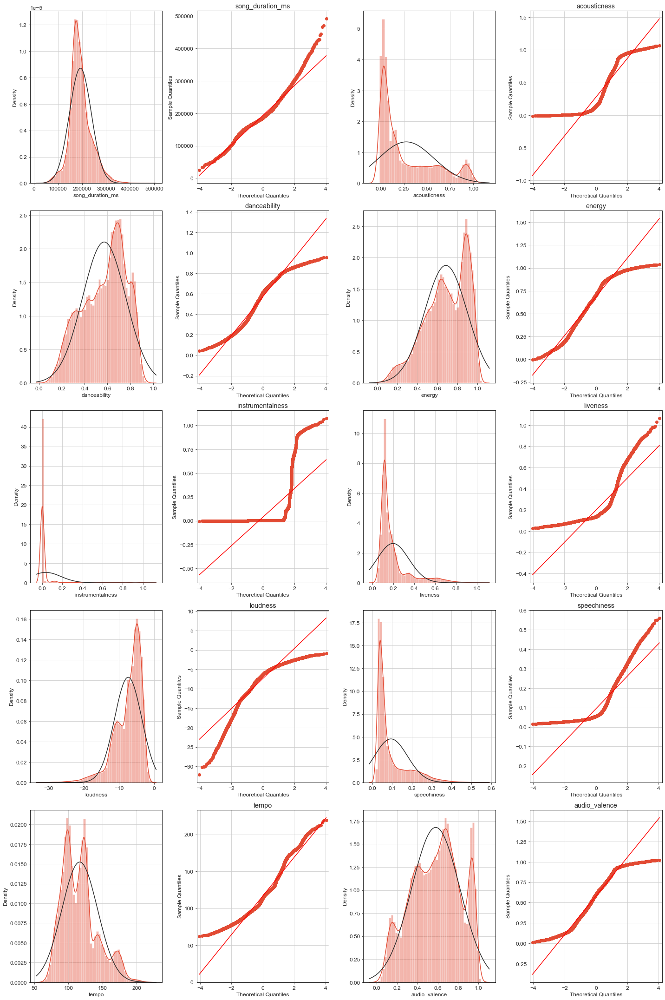

In [29]:
from scipy.stats import norm

num_O_fig_per_row = 2
fig, axs = plt.subplots(len(numerical_cols)//num_O_fig_per_row, 2*num_O_fig_per_row,
                        figsize=(10*num_O_fig_per_row, len(train.columns)*4//num_O_fig_per_row))

for i, col in enumerate(numerical_cols):
    num_O_figs_per_row = (2*num_O_fig_per_row)
    i *= 2
    j = i % num_O_figs_per_row
    i = i // num_O_figs_per_row
    sns.distplot(X[col], ax=axs[i, j], fit=norm)
    sm.qqplot(X[col].dropna(), line="s", ax=axs[i, j+1], fmt='b')
    axs[i, j+1].set_title(col)
    plt.tight_layout()

plt.savefig(f'../reports/figures/qq_plots.png', bbox_inches='tight')
plt.show()

Looking at Quantile-Quantile plot:

- The quantile distributions of `audio_valence`, `speechieness`, `liveness`, `danceability`, `energy` and `acousticness` looks like typical **sigmoid** **S** shape curve. Hence we can probably normalize those features using inverse sigmoid transformation.

$$
S_a^{-1} (x) =  \frac{1}{a}  ln⁡(\frac{x}{1-x})
$$

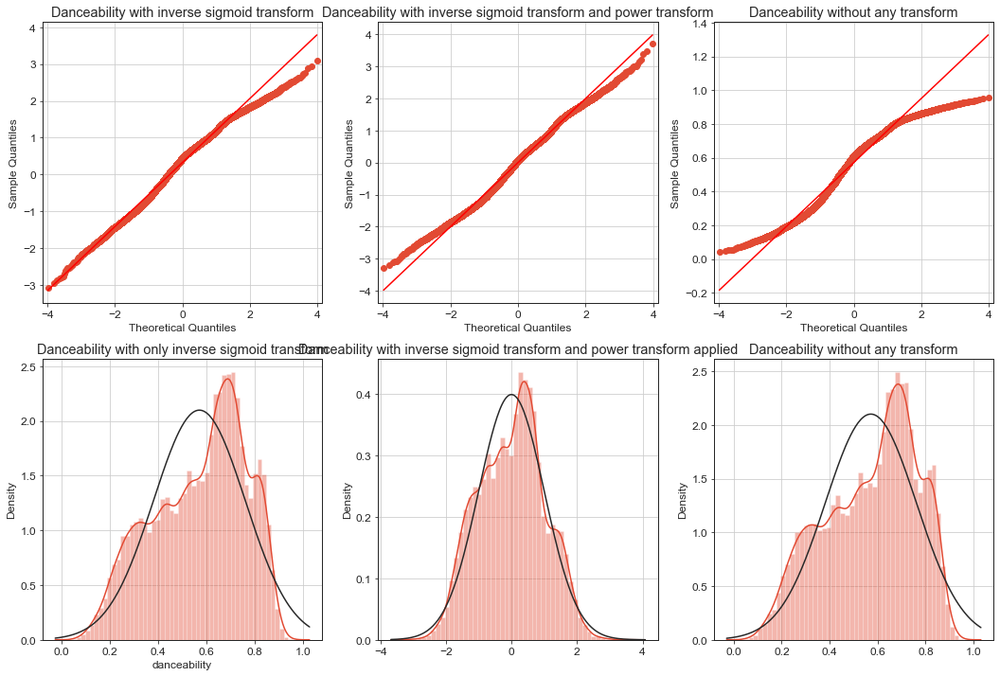

In [30]:
# import power transform

from sklearn.preprocessing import PowerTransformer, power_transform

inv_sigmoid = lambda x: np.log(x / (1-x))
# danceability_processed = PowerTransformer(method='box-cox', standardize=True).fit_transform(X[['danceability']].dropna().apply(inv_sigmoid))

fig, axs = plt.subplots(2, 3, figsize=(6*3, 6*2), )
col = 'danceability'

sm.qqplot(
    X_train[[col]].dropna().apply(inv_sigmoid).to_numpy()[:, 0],
    line="s", fmt='b', ax=axs[0, 0])
axs[0, 0].set_title('Danceability with inverse sigmoid transform')
sns.distplot(X[col], ax=axs[1, 0], fit=norm, kde=True)
axs[1, 0].set_title('Danceability with only inverse sigmoid transform')

sm.qqplot(
    power_transform(
        X_train[[col]].dropna().apply(inv_sigmoid).to_numpy(),
    )[:, 0],
    line="s", fmt='b', ax=axs[0, 1])
axs[0, 1].set_title('Danceability with inverse sigmoid transform and power transform')
sns.distplot(power_transform(
        X_train[[col]].dropna().apply(inv_sigmoid).to_numpy(),
    )[:, 0], ax=axs[1, 1], fit=norm, kde=True)
axs[1, 1].set_title('Danceability with inverse sigmoid transform and power transform applied')

sm.qqplot(
    X_train[[col]].dropna().to_numpy()[:, 0],
    line="s", fmt='b', ax=axs[0, 2])
axs[0, 2].set_title('Danceability without any transform')
sns.distplot(X_train[[col]].dropna().to_numpy()[:, 0], ax=axs[1, 2], fit=norm, kde=True)
axs[1, 2].set_title('Danceability without any transform')

plt.show()

`inverse_sigmoid` transformation followed by power(box-cox) transformation looks more normal


## Feature Interactions

After learning more about each individual feature, we now want to see them interacting with one another.

We will start with studying the impact of the target song_popularity on each individual feature, then look at correlations and relationships between the predictor features, before moving on to even higher dimensional relationships.

### Target Impact
We have seen all the feature distributions, now we want to investigate whether they look different based on the target value.

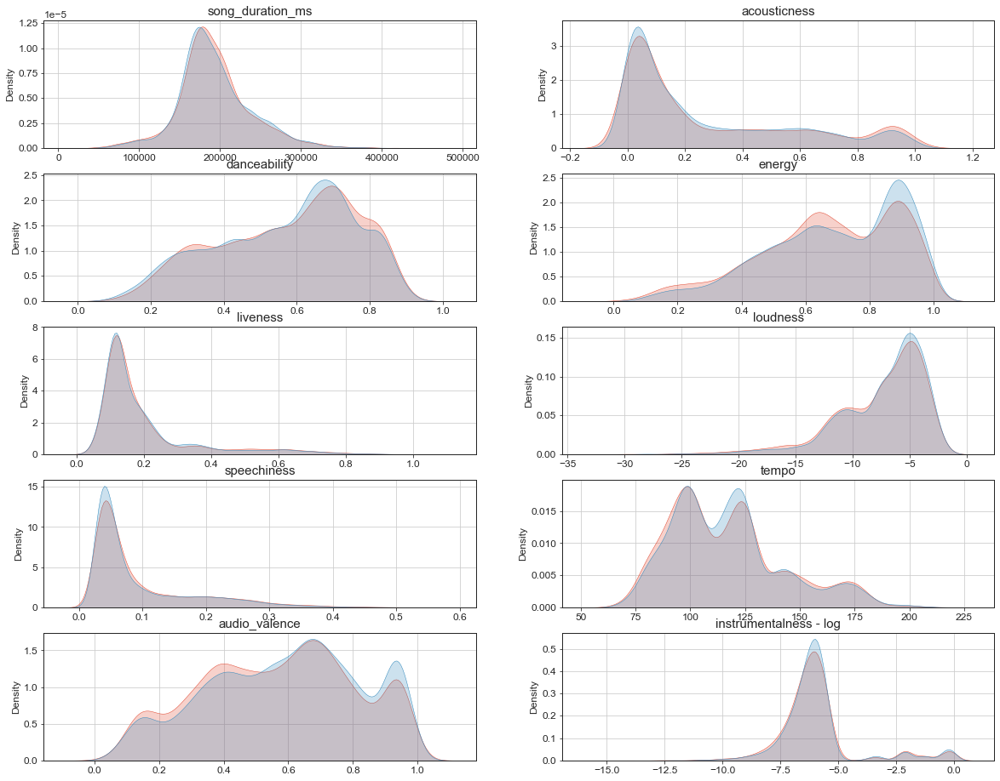

In [35]:
features = FEATURES.copy()
features.append('instrumentalness - log')
features.remove('instrumentalness')

sns.set_style('ticks', {'axes.grid': True})

fig = plt.figure(figsize=(20,16))

axes = [plt.subplot2grid((5, 2), (0, 0)),
        plt.subplot2grid((5, 2), (0, 1)),
        plt.subplot2grid((5, 2), (1, 0)),
        plt.subplot2grid((5, 2), (1, 1)),
        plt.subplot2grid((5, 2), (2, 0)),
        plt.subplot2grid((5, 2), (2, 1)),
        plt.subplot2grid((5, 2), (3, 0)),
        plt.subplot2grid((5, 2), (3, 1)),
        plt.subplot2grid((5, 2), (4, 0)),
        plt.subplot2grid((5, 2), (4, 1))]
i = 0

fueatures = X_train.columns.to_list().append('instrumentalness - log')
for variable in features:
        if variable not in num_categorical and variable != col_y:
                sns.kdeplot(X_train_full[variable][X_train_full[col_y] == True], ax=axes[i], fill = True)
                sns.kdeplot(X_train_full[variable][X_train_full[col_y] == False], ax=axes[i], fill=True)
                axes[i].set_title(variable, fontsize=15)
                axes[i].set_xlabel('')
                i += 1

plt.savefig(f'../reports/figures/bivariate_kde_plots.png', bbox_inches='tight')
plt.show()

There are no features that show strong differences in their distributions for popular vs unpopular songs. No smoking guns here.

Some features like `energy`, `audio_valence`, and perhaps `tempo` show some degree of difference between target classes. Others, like `song_duration_ms` or `liveness` appear to overlap almost perfectly.

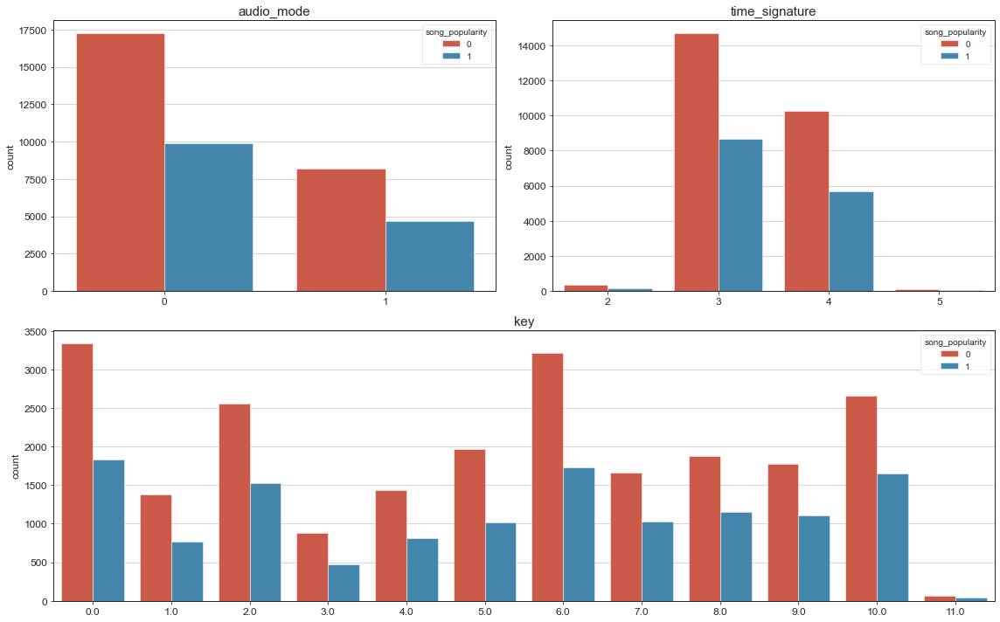

In [36]:
from matplotlib import patches as mpatches

fig = plt.figure(figsize=(16,10))

axes = [plt.subplot2grid((2, 2), (0, 0)),
        plt.subplot2grid((2, 2), (0, 1)),
        plt.subplot2grid((2, 2), (1, 0),  colspan=2)]

for i, variable in enumerate(['audio_mode', 'time_signature', 'key']):
        sns.countplot(x=variable, hue=col_y, data=train, ax=axes[i])
        axes[i].set_title(variable, fontsize=15)
        axes[i].set_xlabel('')

plt.tight_layout()
plt.savefig(f'../reports/figures/count_plots_by_song_popilarity.png', bbox_inches='tight')
plt.show()

This kind of view does tell us as much, though, because the imbalance between popular and unpopular songs appears to be pretty universal for all realisations of all features. In order to see the relative percentages of song_popularity = 1 or 0 (or true vs false as we're expressing it here) we need to compute those fractions for every feature & value combination

### Predictor Feature Interactions

In [37]:
corr_matrix = X_train_full.corr()
corr_matrix

,song_duration_ms,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,audio_valence,song_popularity,instrumentalness - log
song_duration_ms,1.000000,-0.164875,-0.064996,0.144994,-0.024221,0.031935,0.152172,-0.000273,0.085830,-0.009198,-0.005906,-0.053769
acousticness,-0.164875,1.000000,-0.095745,-0.569770,0.073922,-0.126164,-0.534929,-0.127959,-0.185506,-0.252073,0.024032,0.149225
danceability,-0.064996,-0.095745,1.000000,0.103604,-0.150670,0.044440,0.199078,0.177448,-0.087588,0.385932,0.016809,-0.194890
energy,0.144994,-0.569770,0.103604,1.000000,-0.120611,0.155149,0.642650,0.120847,0.221551,0.327261,-0.055454,-0.185054
instrumentalness,-0.024221,0.073922,-0.150670,-0.120611,1.000000,-0.032752,-0.185454,-0.052307,-0.011536,-0.160667,-0.004871,0.758153
liveness,0.031935,-0.126164,0.044440,0.155149,-0.032752,1.000000,0.146623,0.076308,0.065746,0.085344,0.013656,-0.072777
loudness,0.152172,-0.534929,0.199078,0.642650,-0.185454,0.146623,1.000000,0.158312,0.170524,0.359831,-0.039956,-0.264566
speechiness,-0.000273,-0.127959,0.177448,0.120847,-0.052307,0.076308,0.158312,1.000000,0.032935,0.111976,0.025700,-0.112854
tempo,0.085830,-0.185506,-0.087588,0.221551,-0.011536,0.065746,0.170524,0.032935,1.000000,0.022281,-0.008840,-0.046960
audio_valence,-0.009198,-0.252073,0.385932,0.327261,-0.160667,0.085344,0.359831,0.111976,0.022281,1.000000,-0.043264,-0.195736


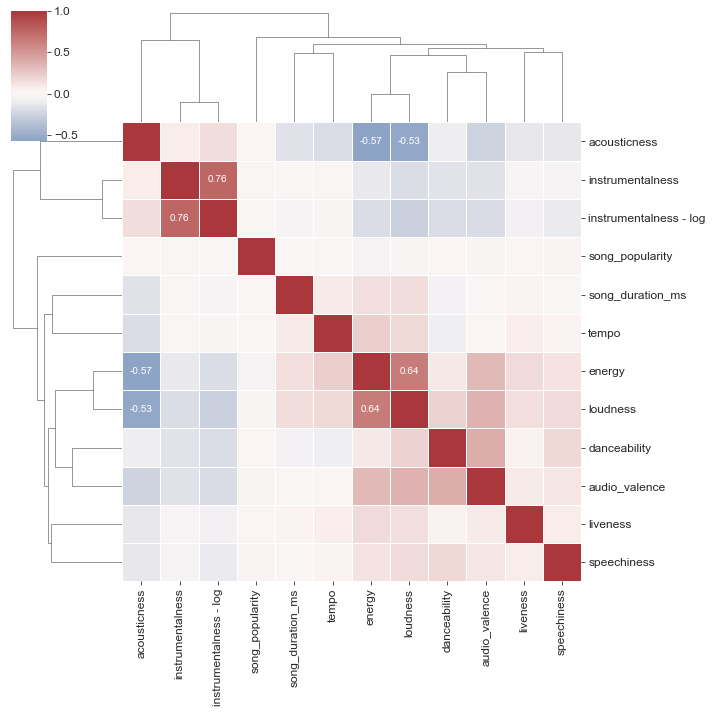

In [38]:
# fig, ax = plt.subplots(figsize=(20, 15))

labels = corr_matrix.applymap(lambda v: str(np.round(v, decimals=2)) if 1 > np.abs(v) >= .5 else '')
mask = np.zeros_like(corr_matrix)
mask[np.tril_indices_from(mask)] = True
sns.clustermap(corr_matrix, center=0, cmap='vlag', linewidth=1, annot=labels, fmt='')
plt.savefig(f'../reports/figures/correlation_matrix.png', bbox_inches='tight')
plt.show()
# sns.heatmap(corr_matrix, cmap='RdBu', linewidth=1, annot=labels, mask=mask, square=True, fmt='')

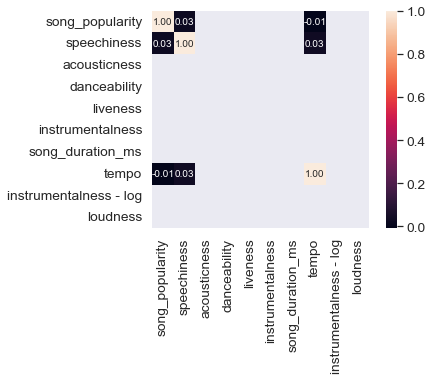

In [39]:
#saleprice correlation matrix
k = 10 #number of variables for heatmap
cols = corr_matrix.nlargest(k, target_variable)[target_variable].index
cm = np.corrcoef(X_train_full[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

We find:

* There's a strong anti-correlation between `acousticness` vs `energy` and `loudness`, respectively. Consequently, `energy` and `loudness` share a strong correlation.

* None of the features individually show a notable correlation with the target `song_popularity`.

* there is some correlation between target variable and `speechiness` but, it very little.

### Categorical feature interactions

<AxesSubplot:xlabel='energy', ylabel='Density'>

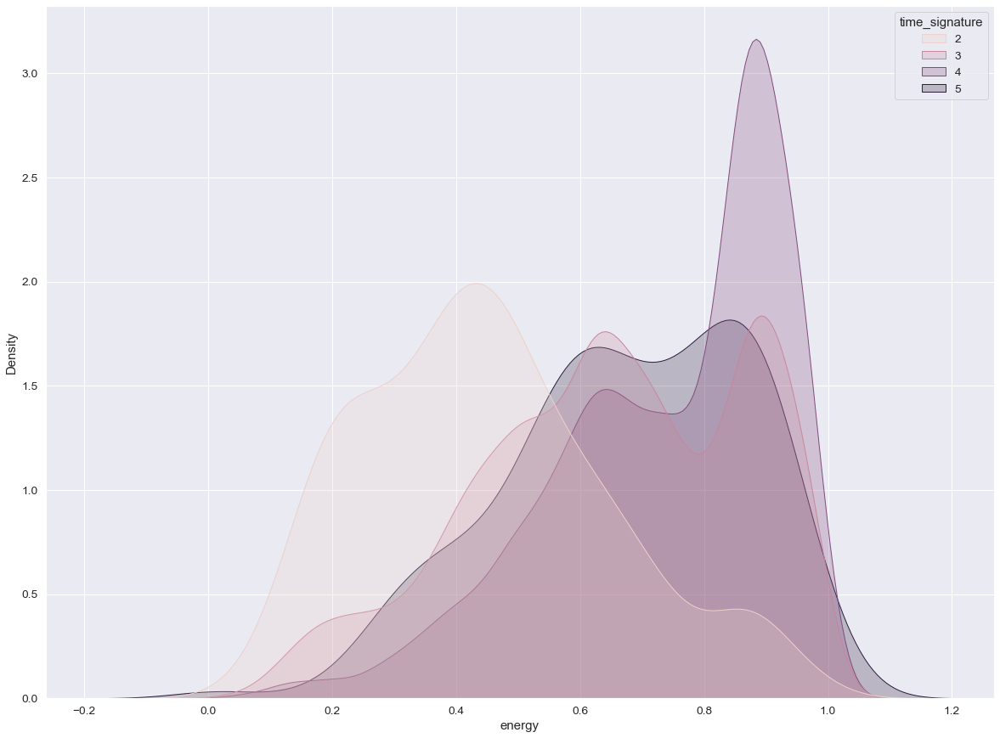

In [40]:
plt.figure(figsize=(20, 15))
sns.kdeplot('energy', hue='time_signature', data=train, fill=True, common_norm=False)

We find:

There are clear differences between the energy peaks for `time_signature = 2` vs `4`.

Smaller differences exist between the other values. `3` and `4` are the categories with the large numbers, and `4` is clearly more energetic than `3`.

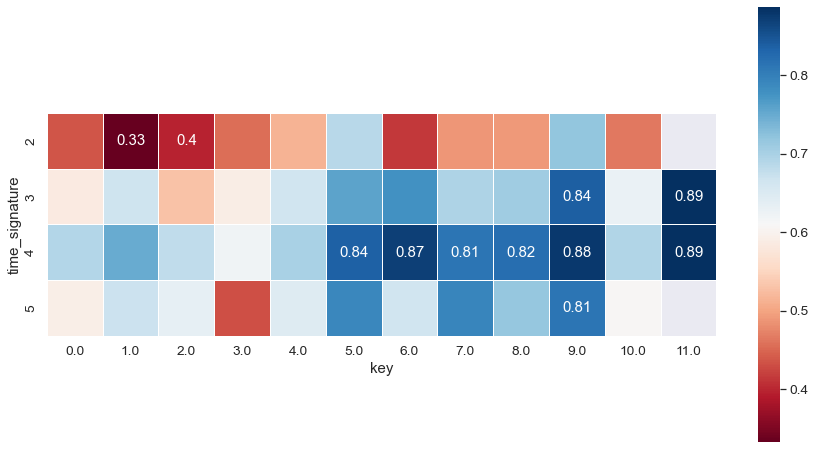

In [41]:
fig, ax = plt.subplots(figsize=(15, 8))

energy_O_key_at_time_signature = train.groupby(['key', 'time_signature']).median()['energy'].unstack().transpose()
labels = energy_O_key_at_time_signature.applymap(lambda v: str(np.round(v, decimals=2)) if np.abs(v) >= .8 or np.abs(v) <= .4 else '')
sns.heatmap(energy_O_key_at_time_signature, cmap='RdBu', linewidth=1, annot=labels, square=True, fmt='')
plt.savefig(f'../reports/figures/energy_O_key_at_time_signature.png', bbox_inches='tight')
plt.show()

We find:

* For `time_signatures` `2` and `5` we have no instances of `key == 11`. This is no big surprise, since those three values are already rare individually, which makes their combinations even more rare.

* The lower keys and time signatures have less energy, on average, than the higher ones. In particular `key` 9 or 11.

### Contionus variables

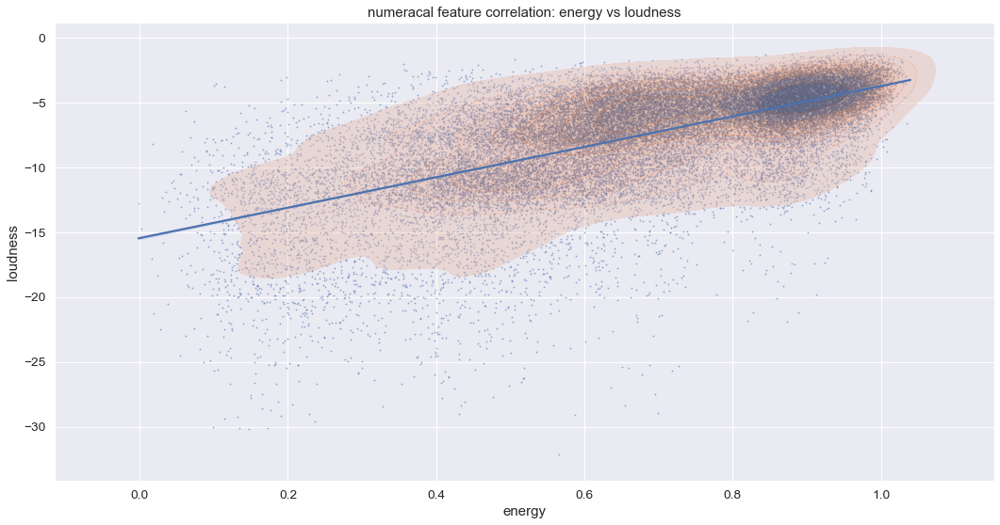

In [42]:
plt.figure(figsize=(15, 8))
ax = sns.regplot(x="energy", y="loudness", data=train, scatter=False)
plt.scatter(train["energy"], train["loudness"], s=1, alpha=.4, axes=ax)
sns.kdeplot(
    data=train, x="energy", y="loudness", fill=True, ax=ax, alpha=.4
)
ax.set_title('numeracal feature correlation: energy vs loudness', fontsize=15)
plt.tight_layout()
plt.savefig(f'../reports/figures/energy_vs_loudness.png', bbox_inches='tight')
plt.show()

We find:

* The relationship looks pretty solid; not just built on outliers or strange.

* The 2 peaks of `energy` don't map 1:1 to the 2 peaks of `loudness` (which has a relatively similar distribution shape).

<Figure size 1080x576 with 0 Axes>

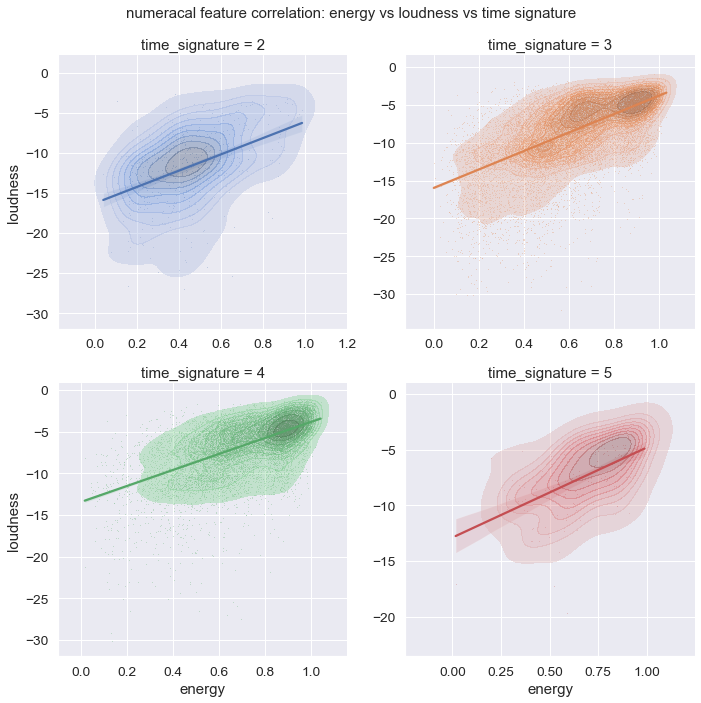

In [43]:
plt.figure(figsize=(15, 8))
ax = sns.FacetGrid(train, hue="time_signature", height=2.5, col_wrap=2, col="time_signature", sharex=False, sharey=False, size=5)
ax.map(sns.regplot, 'energy', 'loudness', scatter=False)
ax.map(sns.scatterplot, 'energy', 'loudness', alpha=.4, s=1)
ax.map(sns.kdeplot, 'energy', 'loudness', alpha=.4, fill=True)
ax.fig.suptitle('numeracal feature correlation: energy vs loudness vs time signature', fontsize=15)
plt.tight_layout()
plt.savefig(f'../reports/figures/energy_vs_loudness_vs_time_signature.png', bbox_inches='tight')
plt.show()

We find:

* Other than the obvious sparsity of the samples with `key` 2 or 5, we see slightly different relations between the better populate 3 and 4 facets.

* The `key == 4` sample appears to have on average fewer values below -15

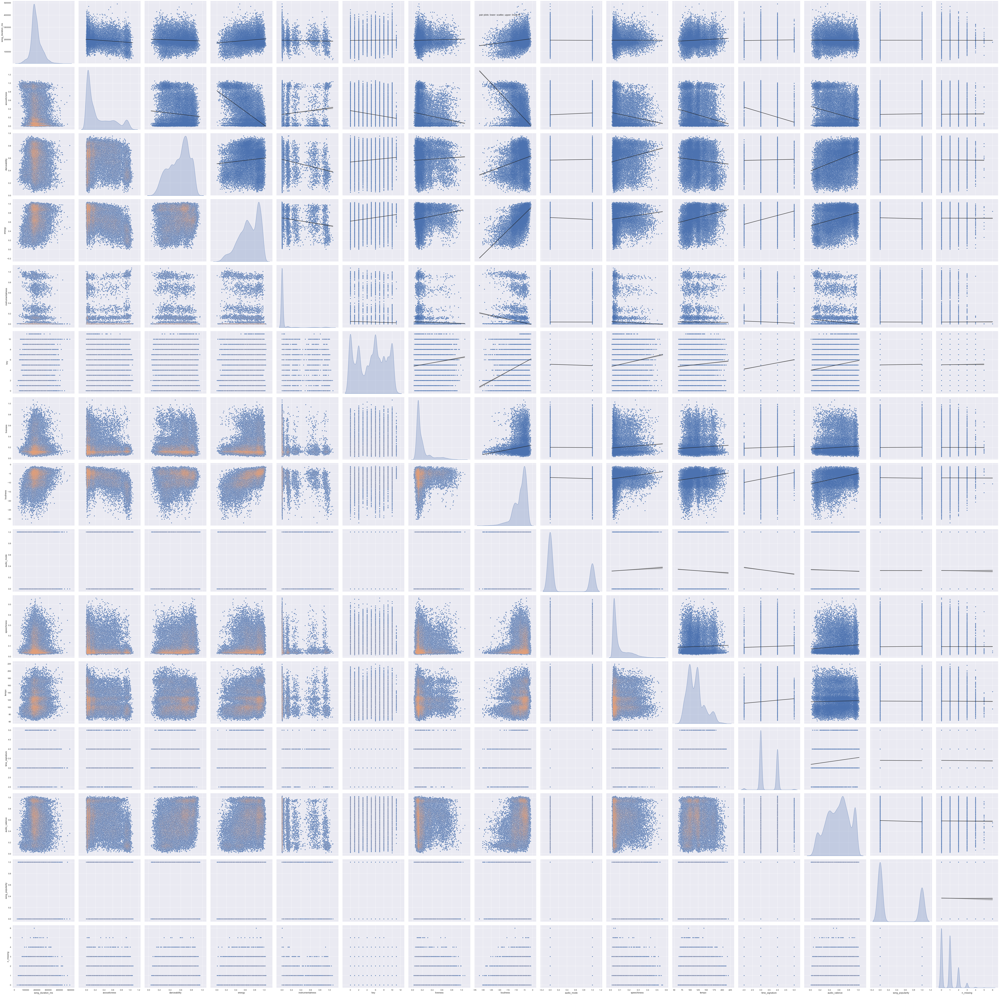

In [44]:
ax = sns.pairplot(train, diag_kind="kde", size=6)
ax.map_lower(sns.scatterplot, s=1, alpha=.4)
ax.map_upper(sns.regplot, line_kws={"color": "k"}, scatter_kws={"s": 1})
ax.fig.suptitle('pair plots: lower: scatter, upper: linear fit', fontsize=15)
plt.tight_layout()
plt.savefig(f'../reports/figures/pair_plots.png', bbox_inches='tight')
plt.show()

We find:

* We've already seen the correlation strengths in the corrplot, and we know the distribution shapes from previous visuals.

* In the scatter facets, there's not much that calls for additional exploration. Most relations represent a pretty direct superposition of their 2 contributing feature distributions (and, for instance, their multi-peak structure).

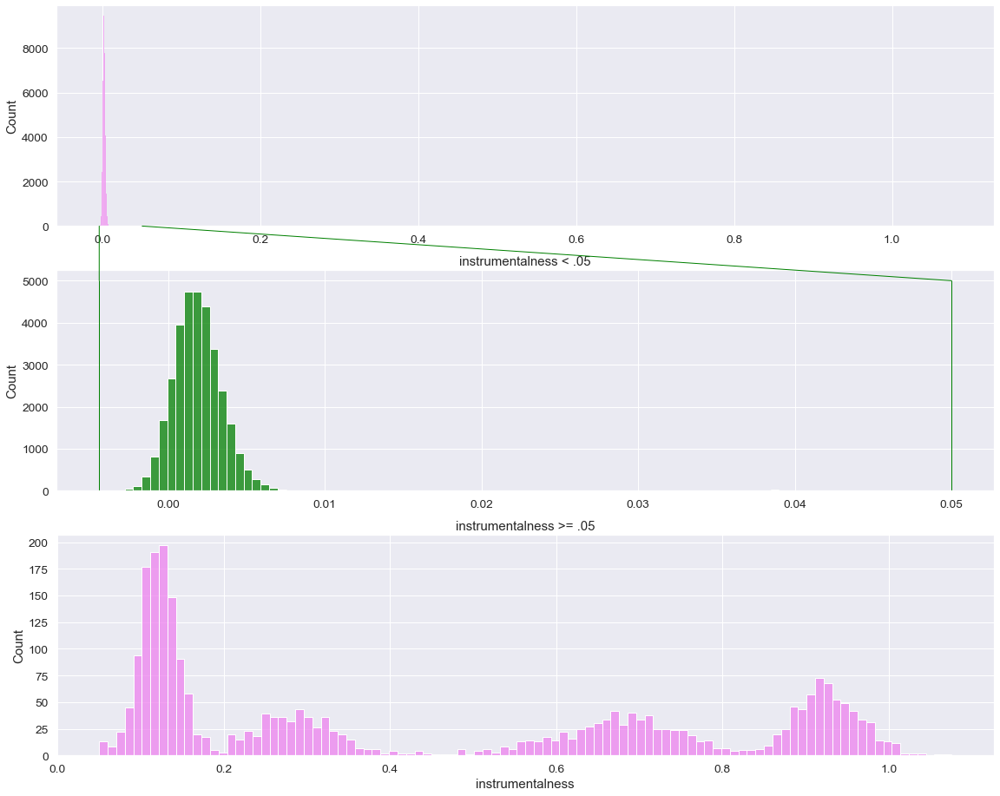

In [45]:
from matplotlib.patches import ConnectionPatch

# zoom in on instrumentalness
fig = plt.figure(figsize=(15, 12))
plt.subplots_adjust(bottom = 0., left = 0, top = 1., right = 1)
sub1 = fig.add_subplot(3,1,1)
sub1 = sns.histplot(train['instrumentalness'], kde=False, bins=1000, color='violet')
sub1.set_xlabel('')

sub2 = fig.add_subplot(3,1,2) # two rows, two columns, second cell
sub2 = sns.histplot(train['instrumentalness'][train['instrumentalness'] < .05], kde=False, bins=100, color='green')
sub2.set_title('instrumentalness < .05', fontsize=15)
sub2.set_xlabel('')
plt.vlines([np.min(train['instrumentalness']), .05], 0, 5000, color='green', linewidth=1, axes=sub2)

sub3 = fig.add_subplot(3,1,3) 
sub3 = sns.histplot(train['instrumentalness'][train['instrumentalness'] >= .05], kde=False, bins=100, color='violet')
sub3.set_title('instrumentalness >= .05', fontsize=15)
con1 = ConnectionPatch(xyA=(0.05, 0), coordsA=sub1.transData, 
                       xyB=(.05, 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con1)
con2 = ConnectionPatch(xyA=(np.min(train['instrumentalness']), 0), coordsA=sub1.transData, 
                       xyB=(np.min(train['instrumentalness']), 5000), coordsB=sub2.transData, color = 'green')
fig.add_artist(con2)

plt.savefig(f'../reports/figures/instrumentalness_histogram.png', bbox_inches='tight')
plt.show()

We find:

* This is a useful result, because it points towards a relatively well behaved part of the distribution below 0.01.

* we earlier found that there might be 2 distributions overlaping one another. We can see that `instrumentalness < .05` is the overlaping distribution showing right skewed gausian distribution, overlaping a multimodal distribution of `instrumentalness >= .05` values

* We know that there are other values above that threshold of 0.05, so let's count both groups:

In [46]:
threshold = .01
inst = (train['instrumentalness'][~train['instrumentalness'].isnull()] < threshold).value_counts()
inst = pd.DataFrame({'subset': ['major distribution', 'minor_subset'], 'n': inst, 'percentage': inst/inst.sum()})
inst.reset_index(inplace=True)
# inst.to_csv(f'../reports/tables/instrumentalness_subset_distribution.csv', index=False)
inst

,index,subset,n,percentage
0,True,major distribution,32763,0.909704
1,False,minor_subset,3252,0.090296


About 91% of `instrumentalness` has values below 0.01 and fall into the "main distribution". The remaining 9% are above that threshold and we will call that the "side distribution".

That's enough sample size (in the side distribution) to plot both parts of `instrumentalness` next to each other, but in separate facets so that the presence of one distribution doesn't make it harder to see the other one. We'll also add some target impact while we're at it:

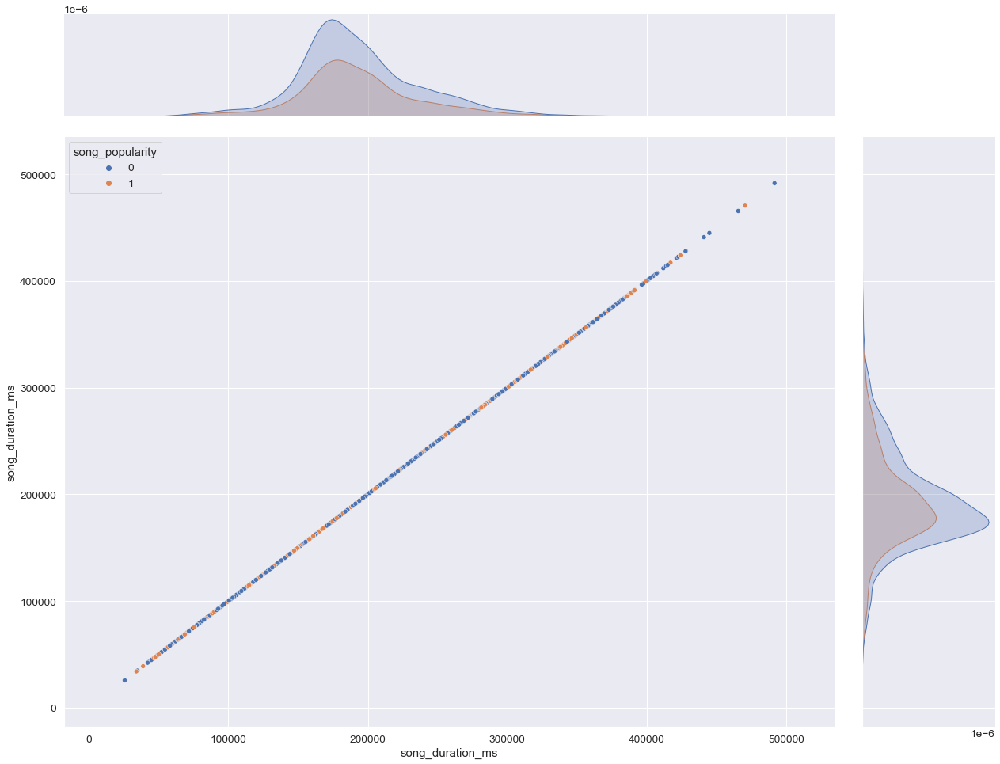

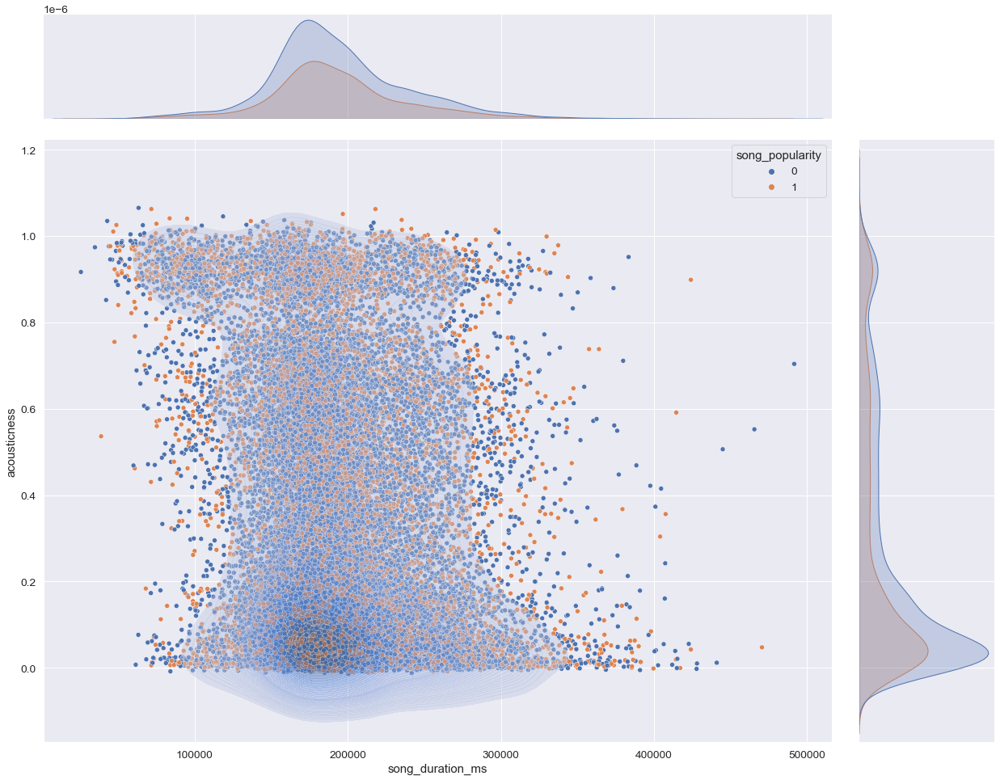

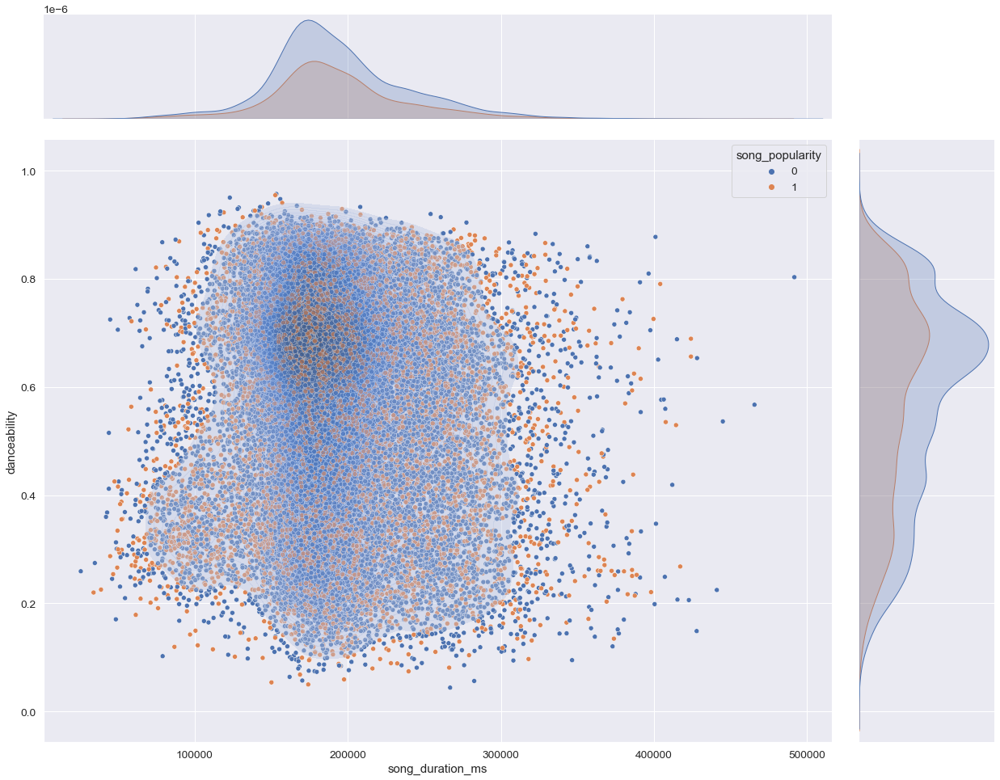

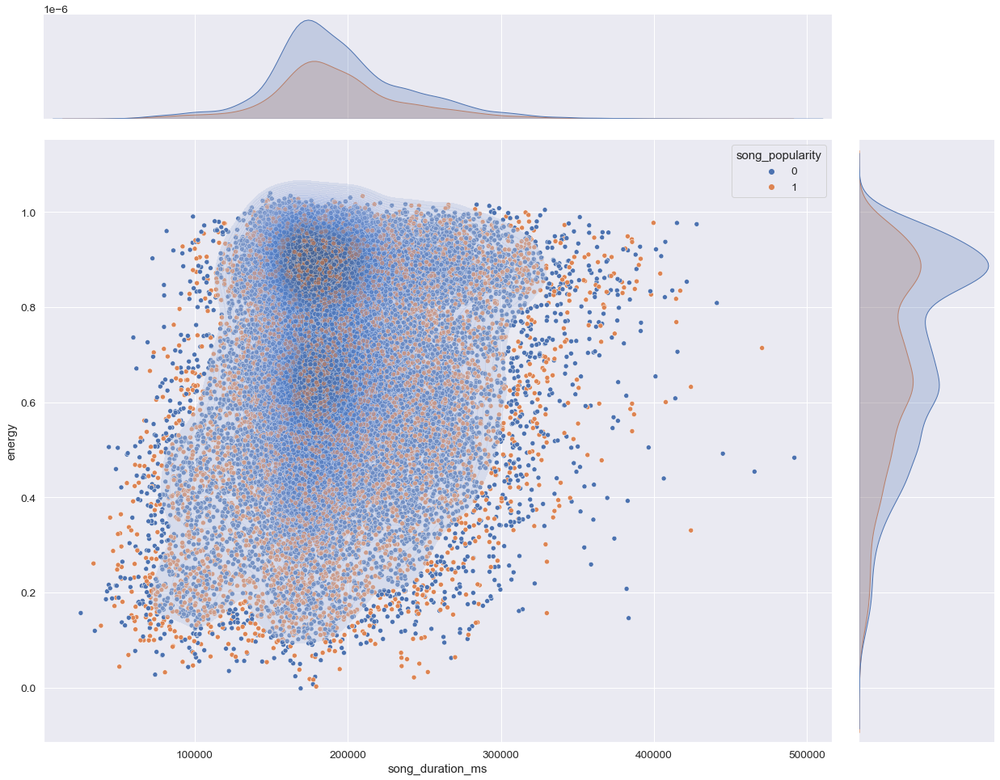

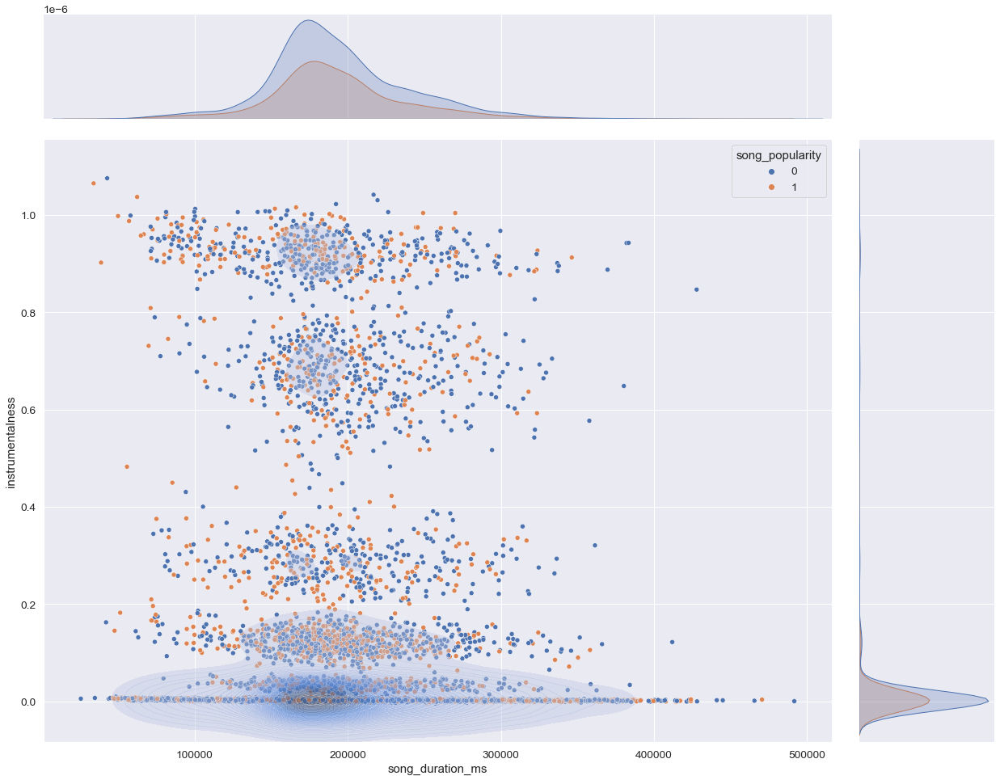

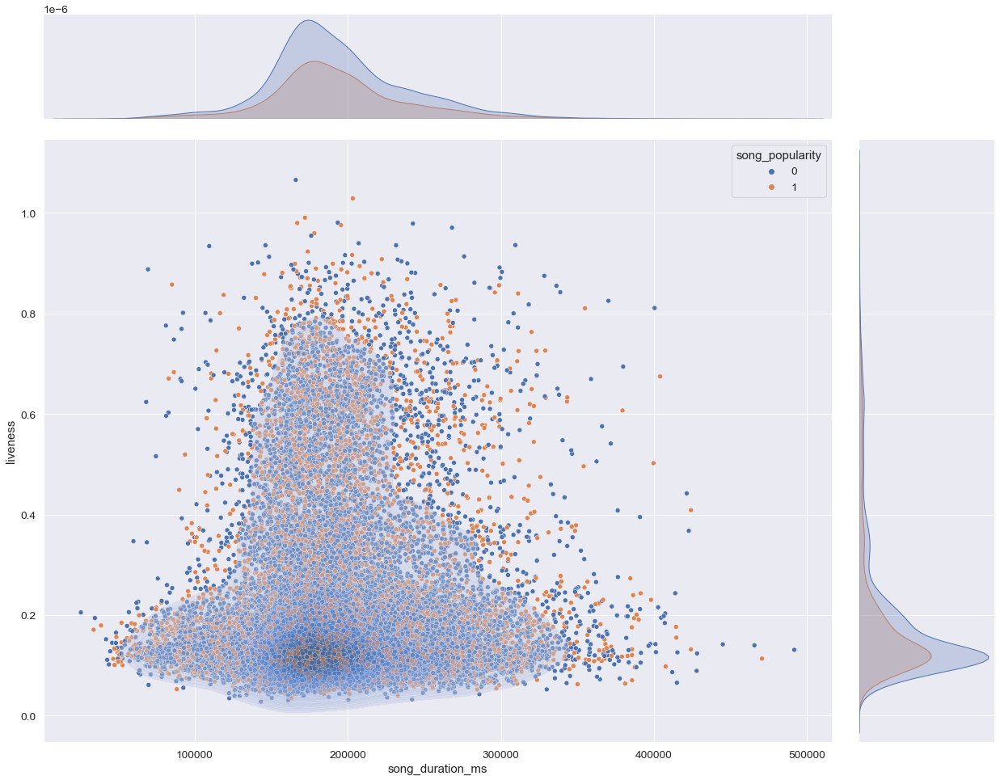

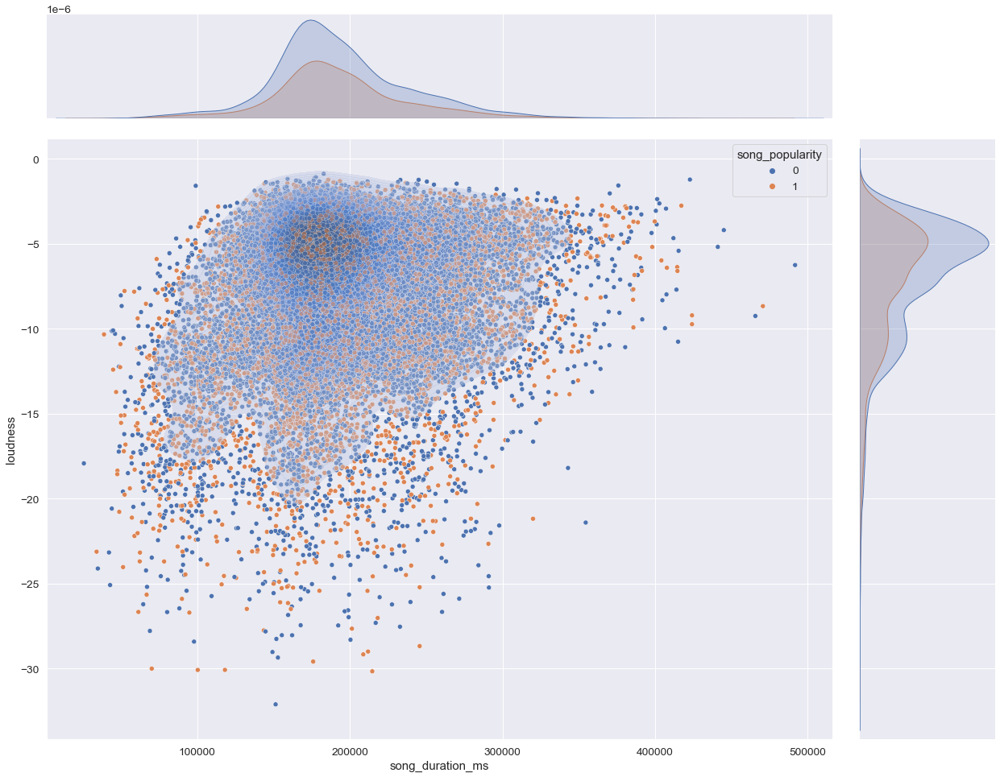

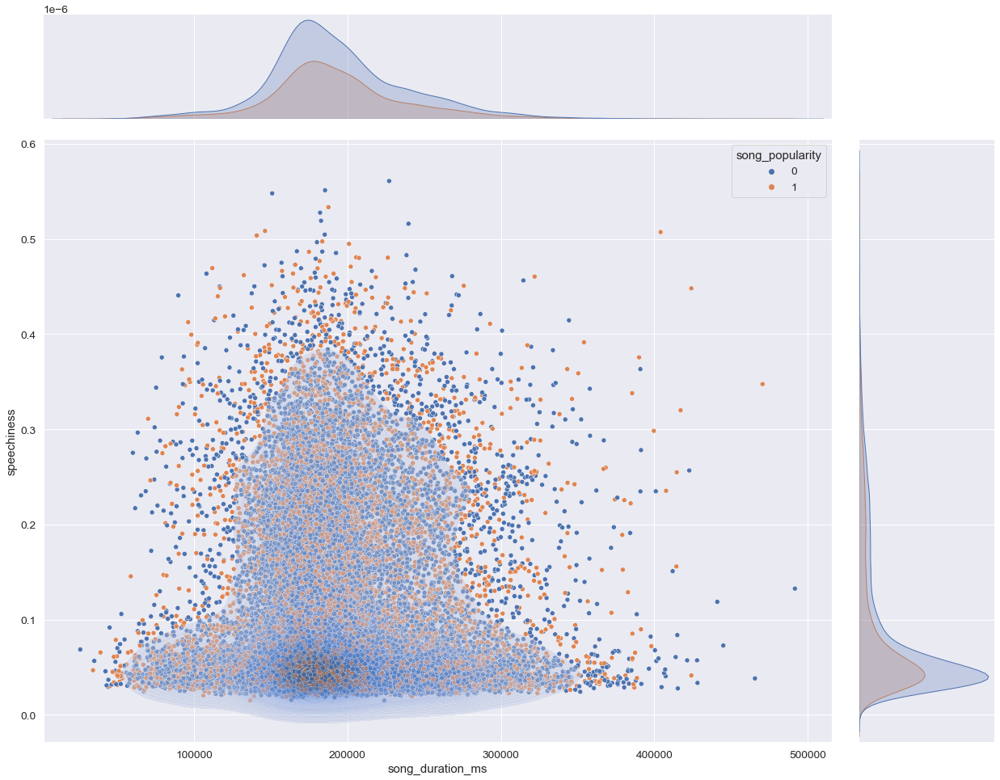

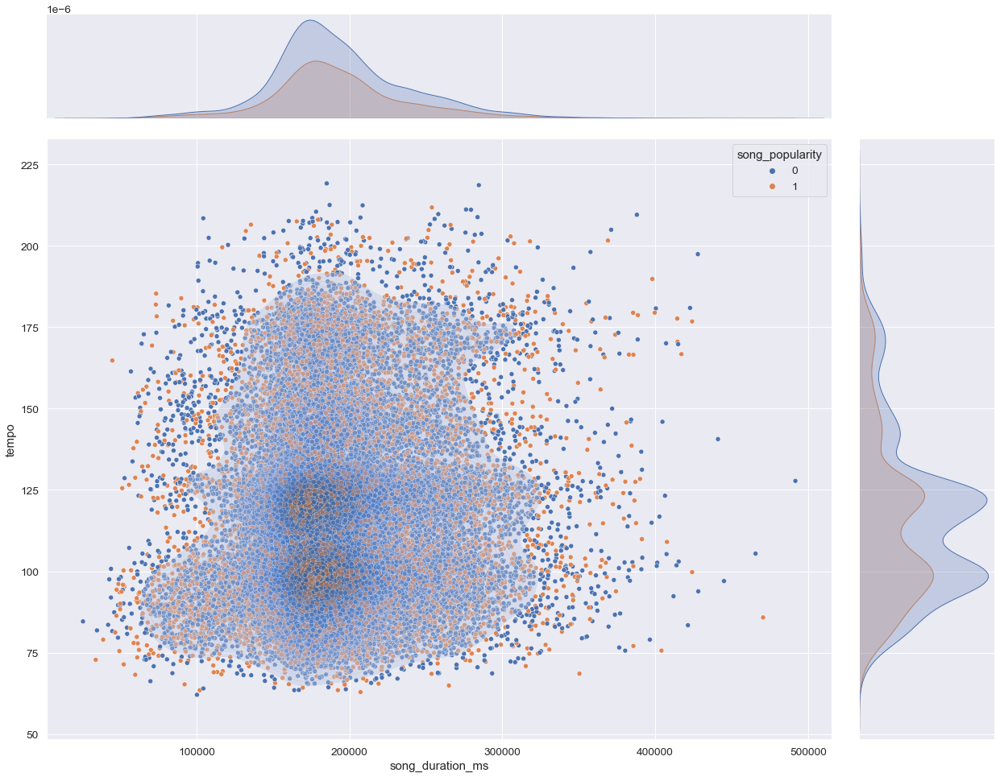

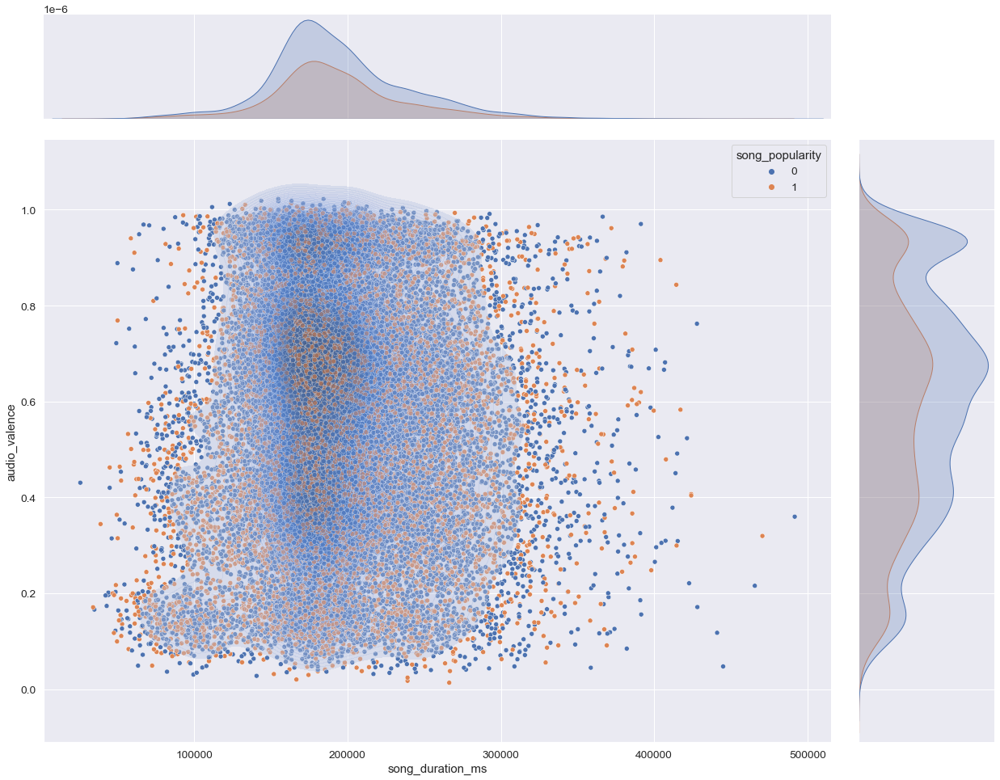

In [47]:
for i in numerical_cols:
  ax = sns.jointplot(data=train, y=i, x='song_duration_ms', hue=col_y)
  if i != 'song_duration_ms':
    sns.kdeplot(data=train, y=i, x='song_duration_ms', n_levels=50, shade=True, alpha=.4, fill=True, ax=ax.ax_joint)
  plt.gcf().set_size_inches(20,15)
  plt.savefig(f'../reports/figures/{i}_vs_song_duration_ms.png', bbox_inches='tight')


Maybe instrumentalness should be tansformed into discrete variables? Or categorical variable?

## On the hunt for outliers

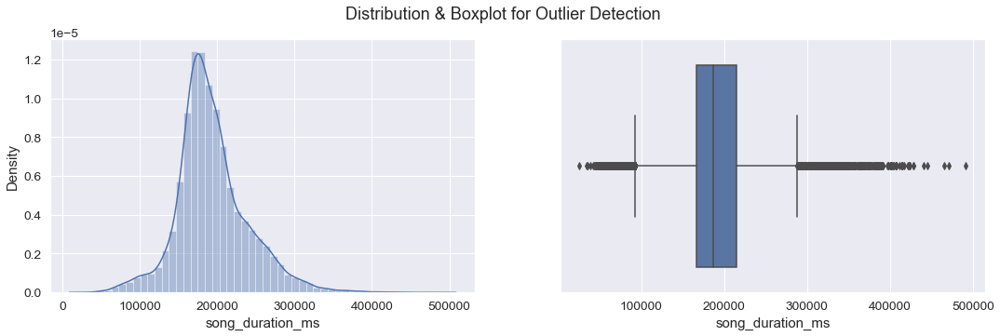

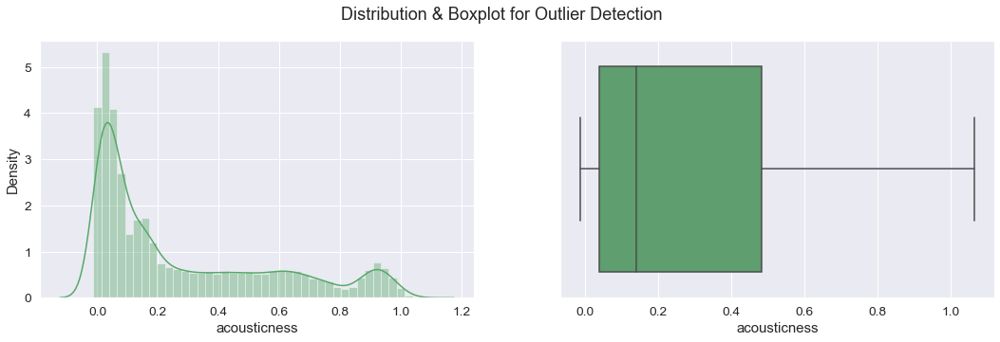

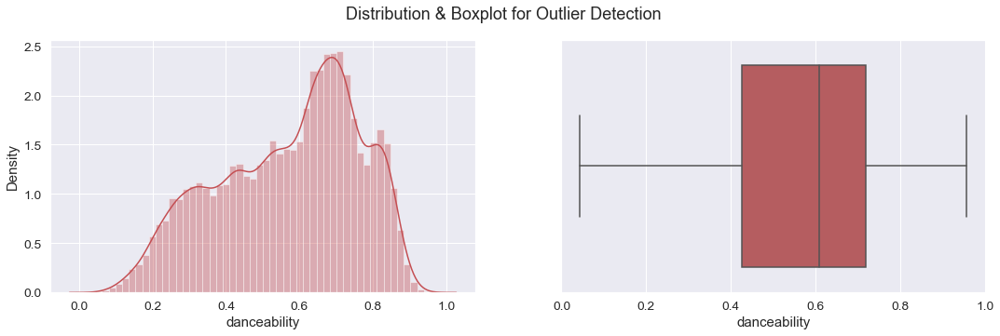

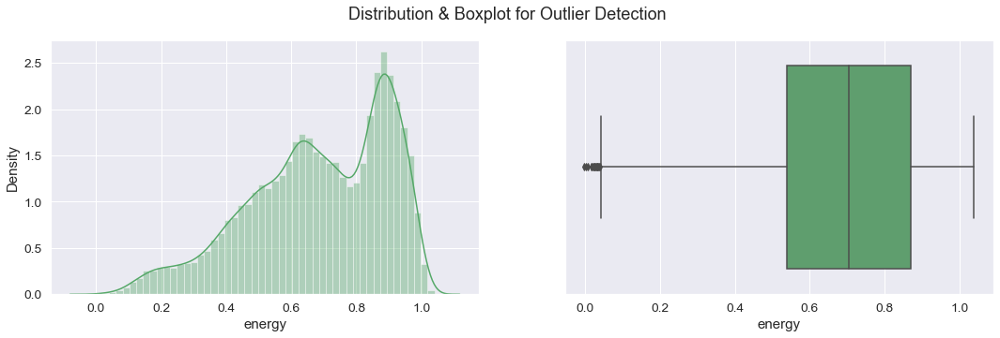

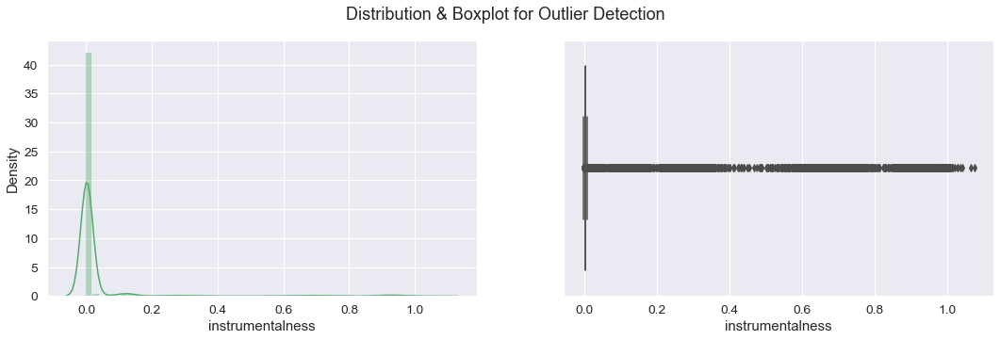

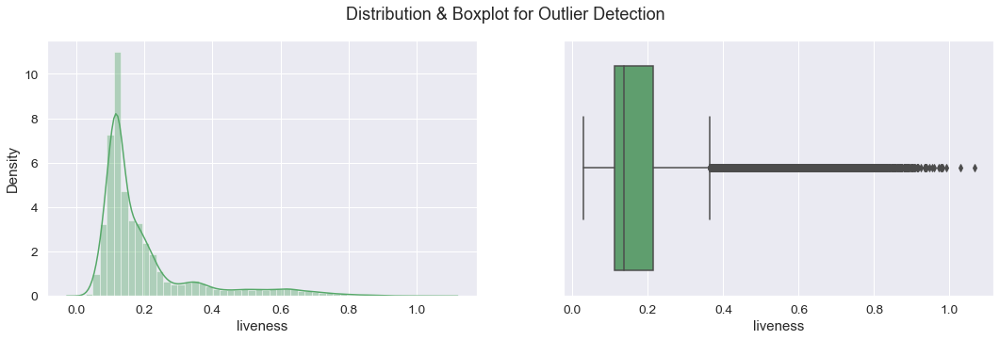

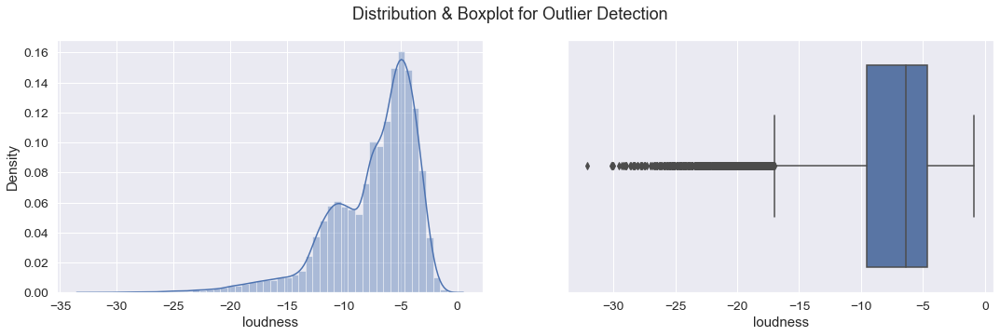

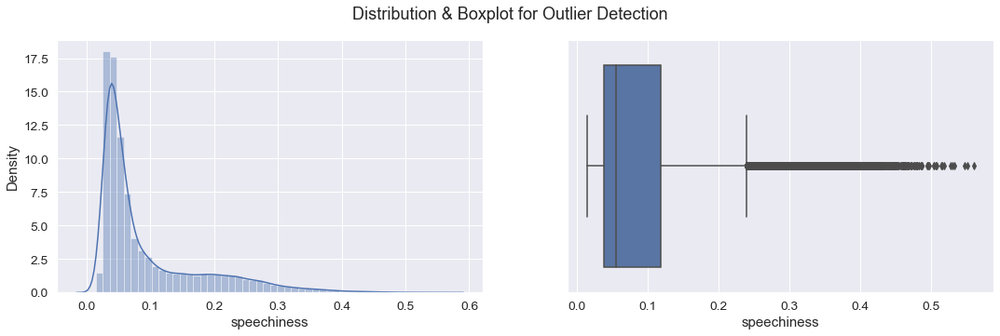

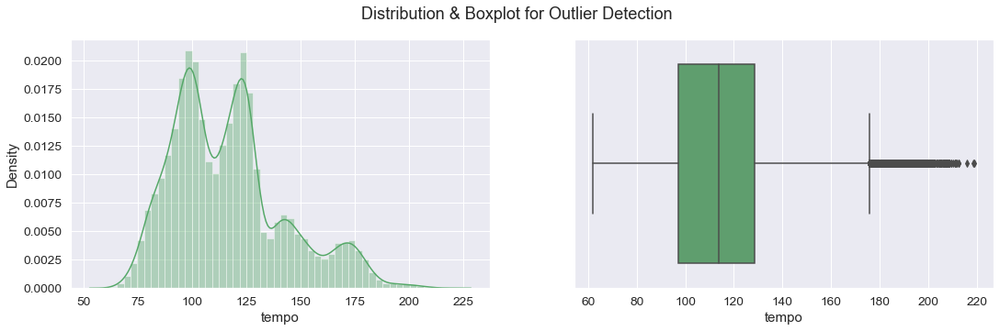

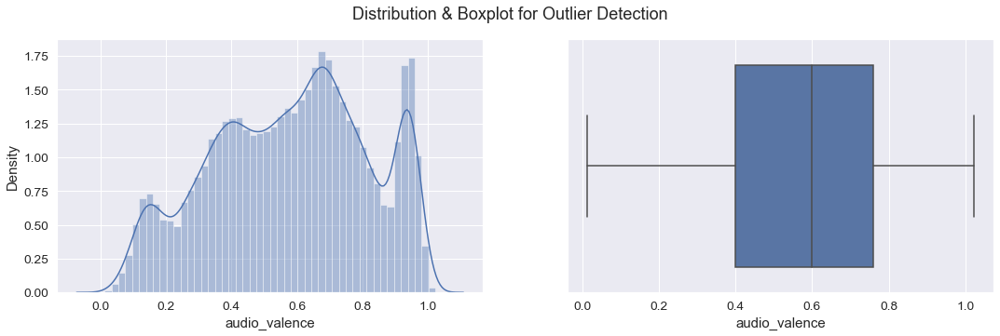

In [48]:
def outlier_viz(col):
    color = random.choice(['r', 'g', 'b'])
    fig, ax = plt.subplots(1,2,figsize=(18,5))
    sns.distplot(col, ax=ax[0], color=color)
    sns.boxplot(col, ax=ax[1], color=color)
    plt.suptitle('Distribution & Boxplot for Outlier Detection')
    fig.show()
    return None

num = ['song_duration_ms', 'acousticness', 'danceability', 'energy',
       'instrumentalness', 'liveness', 'loudness','speechiness', 'tempo', 'audio_valence']

for i in num:
    outlier_viz(train[i])

## Feature Engineering

### imputing na values

#### Simple Imputer

In [49]:
from sklearn.impute import SimpleImputer

simple_mean_imptr = SimpleImputer(strategy="mean", add_indicator=False)
tr_simple_imp = simple_mean_imptr.fit_transform(X_train[FEATURES])
tr_simple_imp = pd.DataFrame(tr_simple_imp, columns=FEATURES)

#### [Iterative Imputer!](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html)

Multivariate imputer that estimates each feature from all the others.

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion.

Uses by default the BayesianRidge model to impute

In [50]:
%%time
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

it_imputer = IterativeImputer(max_iter=10)
train_iterimp = it_imputer.fit_transform(X_train[FEATURES])
train_iterimp = pd.DataFrame(train_iterimp, columns=FEATURES)

CPU times: total: 2.69 s
Wall time: 725 ms


#### [KNN Imputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.KNNImputer.html)

Imputation for completing missing values using k-Nearest Neighbors.

In [51]:
%%time
from sklearn.impute import KNNImputer

knn_imptr = KNNImputer(n_neighbors=5, weights="distance", add_indicator=True)
train_knnimp = knn_imptr.fit_transform(X_train[FEATURES])
mask = X_train.isna().any(axis=0)
imputed_col_names = ["_"+col+"_imputed_" for col in mask[mask].index]

train_knnimp = pd.DataFrame(train_knnimp, columns=FEATURES+imputed_col_names)
train_knnimp.head()

CPU times: total: 49.4 s
Wall time: 37.6 s


,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,...,time_signature,audio_valence,_song_duration_ms_imputed_,_acousticness_imputed_,_danceability_imputed_,_energy_imputed_,_instrumentalness_imputed_,_key_imputed_,_liveness_imputed_,_loudness_imputed_
0,249165.0,0.018023,0.691292,0.782159,0.002070,7.0,0.253386,-4.446018,0.0,0.133197,...,4.0,0.291141,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,262839.0,0.029204,0.296050,0.747173,0.000863,0.0,0.146838,-10.175356,1.0,0.331771,...,4.0,0.476756,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,249180.0,0.231342,0.240227,0.981282,0.003295,6.0,0.111339,-7.609018,0.0,0.095754,...,3.0,0.226383,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,150192.0,0.896027,0.290141,0.260367,0.004380,10.0,0.210436,-12.902434,0.0,0.039707,...,3.0,0.436087,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,169956.0,0.606447,0.784803,0.662214,0.000923,4.0,0.353536,-7.492491,0.0,0.043732,...,3.0,0.343077,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


#### [Iterative Imputer!](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html)

Multivariate imputer that estimates each feature from all the others.

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion.

Uses by default the BayesianRidge model to impute

In [52]:
%%time
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

it_imputer = IterativeImputer(max_iter=10)
train_iterimp = it_imputer.fit_transform(X_train[FEATURES])
train_iterimp = pd.DataFrame(train_iterimp, columns=FEATURES)

CPU times: total: 2.55 s
Wall time: 669 ms


#### Check The Imputation Distribution

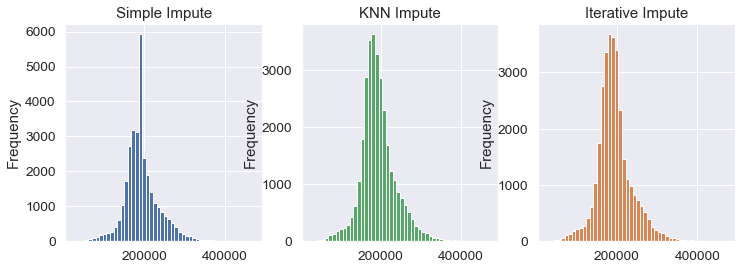

In [53]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs = axs.flatten()
color_pal = plt.rcParams['axes.prop_cycle'].by_key()['color']

tr_simple_imp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[0],
          title='Simple Impute',
         color=color_pal[0])

train_iterimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[2],
          title='Iterative Impute',
         color=color_pal[1])

train_knnimp['song_duration_ms'] \
    .plot(kind='hist',
          bins=50,
          ax=axs[1],
          title='KNN Impute',
         color=color_pal[2])
         
plt.savefig(f'../reports/figures/song_duration_ms_impute.png', bbox_inches='tight')
plt.show()

### handeling outliers

<!-- TODO:

https://machinelearningmastery.com/model-based-outlier-detection-and-removal-in-python/

https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html

https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.FunctionTransformer.html

https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomTreesEmbedding.html#sklearn.ensemble.RandomTreesEmbedding

https://scikit-learn.org/stable/auto_examples/ensemble/plot_feature_transformation.html#sphx-glr-auto-examples-ensemble-plot-feature-transformation-py

https://scikit-learn.org/stable/auto_examples/compose/plot_column_transformer.html#sphx-glr-auto-examples-compose-plot-column-transformer-py

https://scikit-learn.org/stable/modules/generated/sklearn.compose.ColumnTransformer.html#sklearn.compose.ColumnTransformer

https://scikit-learn.org/stable/auto_examples/compose/plot_column_transformer_mixed_types.html#sphx-glr-auto-examples-compose-plot-column-transformer-mixed-types-py -->

In [54]:
# columns used for inverse sigmoid transformation
from sklearn.preprocessing import MinMaxScaler, minmax_scale, PowerTransformer, FunctionTransformer
from sklearn_pandas import DataFrameMapper

col_sig = [
    'acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'speechiness',
    'audio_valence',
]

col_pow = [
    'song_duration_ms',
    'tempo',
]

# make a custom transformer to transform the data
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.base import BaseEstimator, TransformerMixin

class PreProcessorTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, cols, show_impute=False, inplace=False):
        self.show_impute = show_impute
        self.inplace = inplace
        self.col_sig, self.col_pow, self.loudness = cols
        self.cols = self.col_sig + self.col_pow
        self.inv_sigmoid = FunctionTransformer(lambda x: np.log(x / (1-x)))
        self.loudness_transformer = FunctionTransformer(lambda x: np.log1p(-x))
        
    def fit(self, X, y=None):
            
        self.scaler = MinMaxScaler(feature_range=(0+1e-6, 1-1e-6)).fit(X[self.col_sig])
        
        X_tmp = X[self.col_sig+self.col_pow].copy()
        X_tmp[self.col_sig] = self.scaler.transform(X_tmp[self.col_sig])
        X_tmp[self.col_sig] = self.inv_sigmoid.fit_transform(X_tmp[self.col_sig])
        
        self.transformer = PowerTransformer().fit(X_tmp)

        return self
    
    def transform(self, X):

        if not self.inplace:
            X = X.copy()
        
        X[self.col_sig] = self.scaler.transform(X[self.col_sig])
        X[self.col_sig] = self.inv_sigmoid.fit_transform(X[self.col_sig])
        # Box-Cox transformation
        X[self.col_sig+self.col_pow] = self.transformer.transform(X[self.col_sig+self.col_pow])
        X[self.loudness] = self.loudness_transformer.fit_transform(X[self.loudness])
        
        return X

class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, outlier_remover, **kwrgs):
        self.outlier_remover = outlier_remover(**kwrgs)

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        y_hat = self.outlier_remover.fit_predict(X)
        mask = y_hat != -1
        y = y if not y is None else np.zeros(X.shape[0])
        return X.iloc[mask, :], y[mask]

class Imputer(BaseEstimator, TransformerMixin):
    def __init__(self, imputer, **kwrgs):
        self.add_indicator = kwrgs.get('add_indicator', False)
        self.imputer = imputer(**kwrgs)

    def fit(self, X, y=None):
        col = X.columns
        if self.add_indicator:
            mask = X.isna().any(axis=0)
            self.imputed_col_names = col.tolist()+["_"+col+"_imputed_" for col in mask[mask].index]
        else:
            self.imputed_col_names = col

        return self


    def transform(self, X, y=None):
        train_knnimp = self.imputer.fit_transform(X)
        return pd.DataFrame(train_knnimp, columns=self.imputed_col_names)


transformer = PreProcessorTransformer([col_sig, col_pow, 'loudness'])
outlier_remover = OutlierRemover(LocalOutlierFactor, n_neighbors=20, contamination=0.02)
imputer = Imputer(IterativeImputer, add_indicator=True, max_iter=10)

In [55]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import FunctionTransformer
from sklearn import set_config

set_config(display="diagram")

# todo: https://www.analyticsvidhya.com/blog/2021/05/understanding-column-transformer-and-machine-learning-pipelines/
# outlier_remover = LocalOutlierFactor(n_neighbors=20, contamination=0.02, novelty=True)

pipe = Pipeline([
    ("na-imputation", imputer),
    ("transformation", transformer),
    ('outlier remover', outlier_remover),
])
pipe

Pipeline(steps=[('na-imputation',
                 Imputer(imputer=IterativeImputer(add_indicator=True))),
                ('transformation',
                 PreProcessorTransformer(cols=['acousticness', 'danceability',
                                               'energy', 'instrumentalness',
                                               'liveness', 'speechiness',
                                               'audio_valence',
                                               'song_duration_ms', 'tempo'])),
                ('outlier remover',
                 OutlierRemover(outlier_remover=LocalOutlierFactor(contamination=0.02)))])

In [56]:
pipe.fit(X_train)
X_train_processed = pipe.transform(X_train)[0]
X_train_processed.to_csv("../data/processed/X_train_processed.csv", index=False)

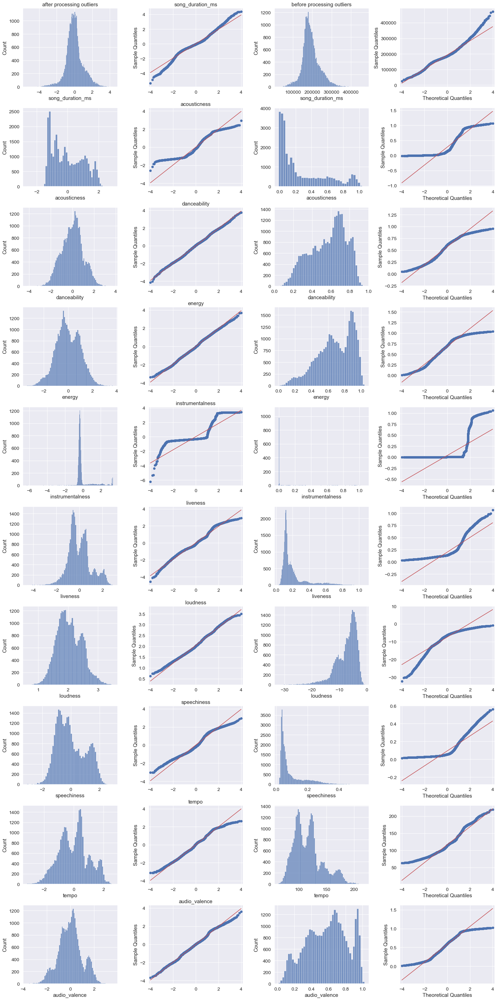

In [57]:
fig, axs = plt.subplots(len(numerical_cols), 4,
                        figsize=(10*2, len(numerical_cols)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X_train_processed[col], ax=axs[i, 0])
    sm.qqplot(X_train_processed[col].dropna(), line="s", ax=axs[i, 1], fmt='r')
    sns.histplot(X_train[col], ax=axs[i, 2])
    sm.qqplot(X_train[col].dropna(), line="s", ax=axs[i, 3], fmt='r')
    axs[i, 1].set(xlabel='')
    axs[i, 1].set_title(col)

axs[0, 2].set_title('before processing outliers')
axs[0, 0].set_title('after processing outliers')
plt.tight_layout()
# plt.savefig('../reports/figures/outlier_removal.png')

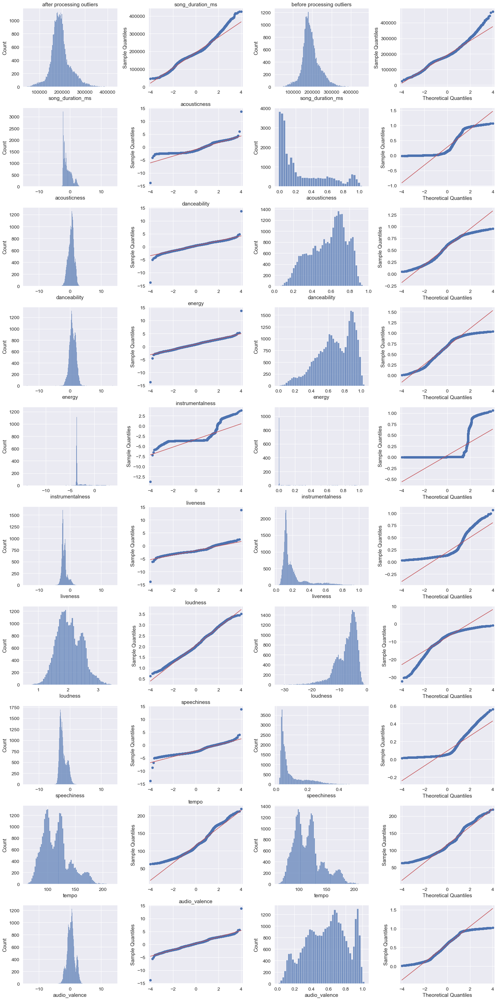

In [58]:
class PreProcessorTransformerUsingInvSigmoid(BaseEstimator, TransformerMixin):
    def __init__(self, cols, show_impute=False, inplace=False):
        self.show_impute = show_impute
        self.inplace = inplace
        self.col_sig, self.col_pow, self.loudness = cols
        self.cols = self.col_sig + self.col_pow
        self.inv_sigmoid = FunctionTransformer(lambda x: np.log(x / (1-x)))
        self.loudness_transformer = FunctionTransformer(lambda x: np.log1p(-x))
        
    def fit(self, X, y=None):
            
        self.scaler = MinMaxScaler(feature_range=(0+1e-6, 1-1e-6)).fit(X[self.col_sig])
        
        X_tmp = X[self.col_sig+self.col_pow].copy()
        X_tmp[self.col_sig] = self.scaler.transform(X_tmp[self.col_sig])
        X_tmp[self.col_sig] = self.inv_sigmoid.fit_transform(X_tmp[self.col_sig])
        
        # self.transformer = PowerTransformer().fit(X_tmp)

        return self
    
    def transform(self, X):

        if not self.inplace:
            X = X.copy()
        
        X[self.col_sig] = self.scaler.transform(X[self.col_sig])
        X[self.col_sig] = self.inv_sigmoid.fit_transform(X[self.col_sig])
    #    # Box-Cox transformation
        # X[self.col_sig+self.col_pow] = self.transformer.transform(X[self.col_sig+self.col_pow])
        X[self.loudness] = self.loudness_transformer.fit_transform(X[self.loudness])
        
        return X

transformer_inv_sig = PreProcessorTransformerUsingInvSigmoid([col_sig, col_pow, 'loudness'])
pipe_inv_sig = Pipeline([
    ("na-imputation", imputer),
    ("transformation", transformer_inv_sig),
    ('outlier remover', outlier_remover),
])
pipe_inv_sig.fit(X_train)
X_train_processed_inv_sig = pipe_inv_sig.transform(X_train)[0]
X_train_processed_inv_sig.to_csv("../data/interim/X_train_processed_inv_sig.csv", index=False)

fig, axs = plt.subplots(len(numerical_cols), 4,
                        figsize=(10*2, len(numerical_cols)*4))

for i, col in enumerate(numerical_cols):
    sns.histplot(X_train_processed_inv_sig[col], ax=axs[i, 0])
    sm.qqplot(X_train_processed_inv_sig[col].dropna(), line="s", ax=axs[i, 1], fmt='r')
    sns.histplot(X_train[col], ax=axs[i, 2])
    sm.qqplot(X_train[col].dropna(), line="s", ax=axs[i, 3], fmt='r')
    axs[i, 1].set(xlabel='')
    axs[i, 1].set_title(col)

axs[0, 2].set_title('before processing outliers')
axs[0, 0].set_title('after processing outliers')
plt.tight_layout()

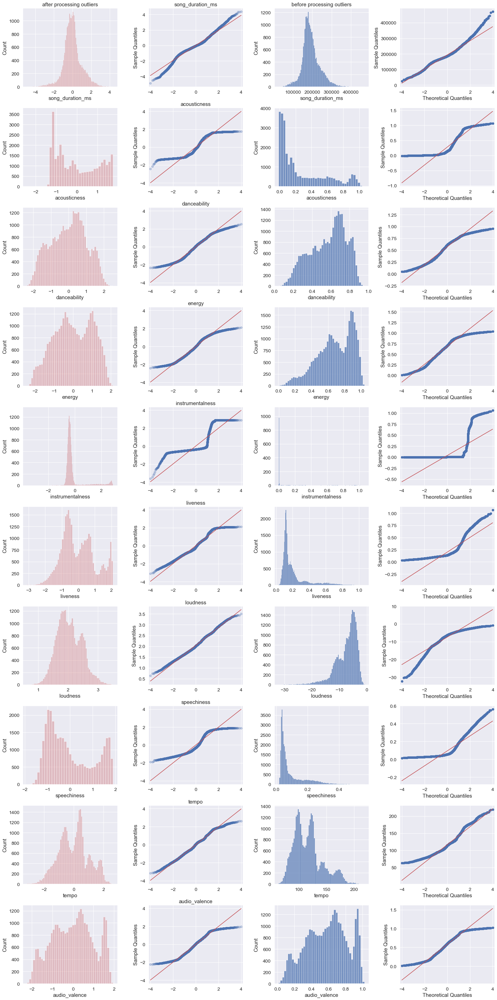

In [59]:
class PreProcessorTransformerUsingBoxCox(BaseEstimator, TransformerMixin):
    def __init__(self, cols, show_impute=False, inplace=False):
        self.show_impute = show_impute
        self.inplace = inplace
        self.col_sig, self.col_pow, self.loudness = cols
        self.cols = self.col_sig + self.col_pow
        # self.inv_sigmoid = FunctionTransformer(lambda x: x)
        self.loudness_transformer = FunctionTransformer(lambda x: np.log1p(-x))
        
    def fit(self, X, y=None):
            
        self.scaler = MinMaxScaler(feature_range=(0+1e-6, 1-1e-6)).fit(X[self.col_sig])
        
        X_tmp = X[self.col_sig+self.col_pow].copy()
        X_tmp[self.col_sig] = self.scaler.transform(X_tmp[self.col_sig])
        # X_tmp[self.col_sig] = self.inv_sigmoid.fit_transform(X_tmp[self.col_sig])
        
        self.transformer = PowerTransformer().fit(X_tmp)

        return self
    
    def transform(self, X):

        if not self.inplace:
            X = X.copy()
        
        X[self.col_sig] = self.scaler.transform(X[self.col_sig])
        # X[self.col_sig] = self.inv_sigmoid.fit_transform(X[self.col_sig])
    #    # Box-Cox transformation
        X[self.col_sig+self.col_pow] = self.transformer.transform(X[self.col_sig+self.col_pow])
        X[self.loudness] = self.loudness_transformer.fit_transform(X[self.loudness])
        
        return X

transformer = PreProcessorTransformerUsingBoxCox([col_sig, col_pow, 'loudness'])

pipe_box_cox = Pipeline([
    ("na-imputation", imputer),
    ("transformation", transformer),
    ('outlier remover', outlier_remover),
])

pipe_box_cox.fit(X_train)
X_train_processed_box_cox = pipe_box_cox.transform(X_train)[0]
X_train_processed_box_cox.to_csv("../data/interim/X_train_processed_box_cox.csv", index=False)

fig, axs = plt.subplots(len(numerical_cols), 4,
                        figsize=(10*2, len(numerical_cols)*4))

for i, col in enumerate(numerical_cols):

    sns.histplot(X_train_processed_box_cox[col], ax=axs[i, 0], label='box-cox', alpha=0.3, color='r')
    # sns.histplot(X_train_processed_inv_sig[col], ax=axs[i, 0], label='inverse-sigmoid', alpha=.3, color='g')
    # sns.histplot(X_train_processed[col], ax=axs[i, 0], label='both transformations', alpha=.3, color='b')
    sm.qqplot(X_train_processed_box_cox[col].dropna(), line="s", ax=axs[i, 1], fmt='r', label='box-cox', alpha=.3)
    # sm.qqplot(X_train_processed_inv_sig[col].dropna(), linestyle="solid", ax=axs[i, 1], fmt='g', label='inverse-sigmoid', alpha=.3)
    # sm.qqplot(X_train_processed[col].dropna(), linestyle="dashed", ax=axs[i, 1], fmt='b', label='both transformations', alpha=.3)
    sns.histplot(X_train[col], ax=axs[i, 2])
    sm.qqplot(X_train[col].dropna(), line="s", ax=axs[i, 3], fmt='r')
    axs[i, 1].set(xlabel='')
    axs[i, 1].set_title(col)

axs[0, 2].set_title('before processing outliers')
axs[0, 0].set_title('after processing outliers')
plt.tight_layout()

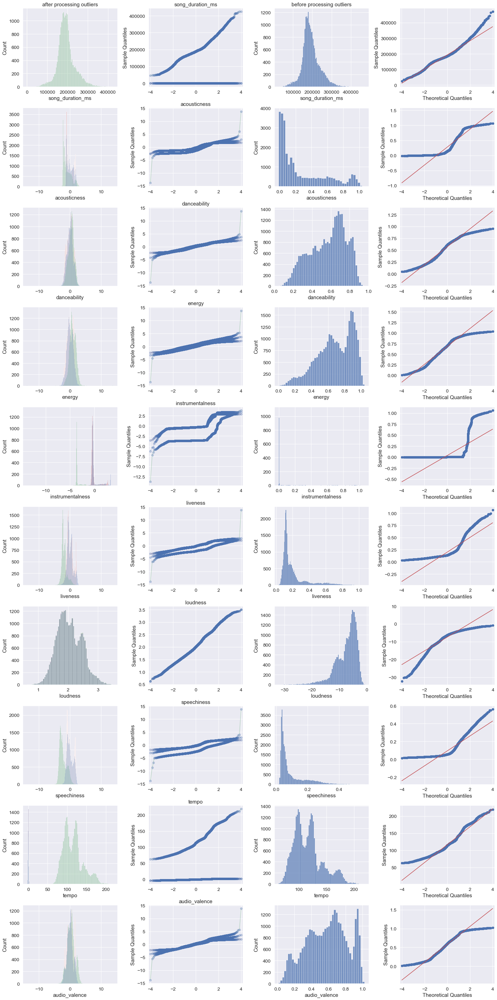

In [60]:
fig, axs = plt.subplots(len(numerical_cols), 4,
                        figsize=(10*2, len(numerical_cols)*4))
                        
for i, col in enumerate(numerical_cols):

    sns.histplot(X_train_processed_box_cox[col], ax=axs[i, 0], label='box-cox', alpha=0.3, color='r')
    sns.histplot(X_train_processed_inv_sig[col], ax=axs[i, 0], label='inverse-sigmoid', alpha=.3, color='g')
    sns.histplot(X_train_processed[col], ax=axs[i, 0], label='both transformations', alpha=.3, color='b')
    sm.qqplot(X_train_processed_box_cox[col].dropna(), linestyle="solid", ax=axs[i, 1], fmt='r', label='box-cox', alpha=.3)
    sm.qqplot(X_train_processed_inv_sig[col].dropna(), linestyle="solid", ax=axs[i, 1], fmt='g', label='inverse-sigmoid', alpha=.3)
    sm.qqplot(X_train_processed[col].dropna(), linestyle="dashed", ax=axs[i, 1], fmt='b', label='both transformations', alpha=.3)
    sns.histplot(X_train[col], ax=axs[i, 2])
    sm.qqplot(X_train[col].dropna(), line="s", ax=axs[i, 3], fmt='r')
    axs[i, 1].set(xlabel='')
    axs[i, 1].set_title(col)

axs[0, 2].set_title('before processing outliers')
axs[0, 0].set_title('after processing outliers')
plt.tight_layout()
plt.show()

yep! looks normalized(gaussian distributed) now. Though `instrumentalness` still looks weird, all of the features share same range.

## EDA 2.0 - Unsupervised Learning

TODO:

https://scikit-learn.org/stable/auto_examples/compose/plot_compare_reduction.html#sphx-glr-auto-examples-compose-plot-compare-reduction-py

### Feature Engineering - Clustering

earlier we found that `instrumentalness` can be categorized into approximately 5-6 clusters

In [61]:
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering, Birch
from sklearn.preprocessing import StandardScaler, MinMaxScaler

#### kmeans

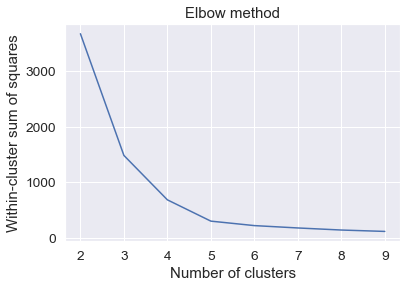

In [62]:
scaler = StandardScaler()
X_subset = train_knnimp[['instrumentalness']]
X_subset = scaler.fit_transform(X_subset)
wsss = []

for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=0).fit(X_subset)
    wsss.append(kmeans.inertia_)

plt.plot(range(2, 10), wsss)
plt.xlabel('Number of clusters')
plt.ylabel('Within-cluster sum of squares')
plt.title('Elbow method')
plt.savefig('../reports/figures/elbow_method.png')
plt.show()

optimal number of clusters might be 3, 4 or 5

In [63]:
scaler = StandardScaler()
X_subset = train_knnimp[['instrumentalness']]
X_subset = scaler.fit_transform(X_subset)

kmeans = KMeans(n_clusters=5, random_state=0).fit(X_subset)
labels = kmeans.labels_

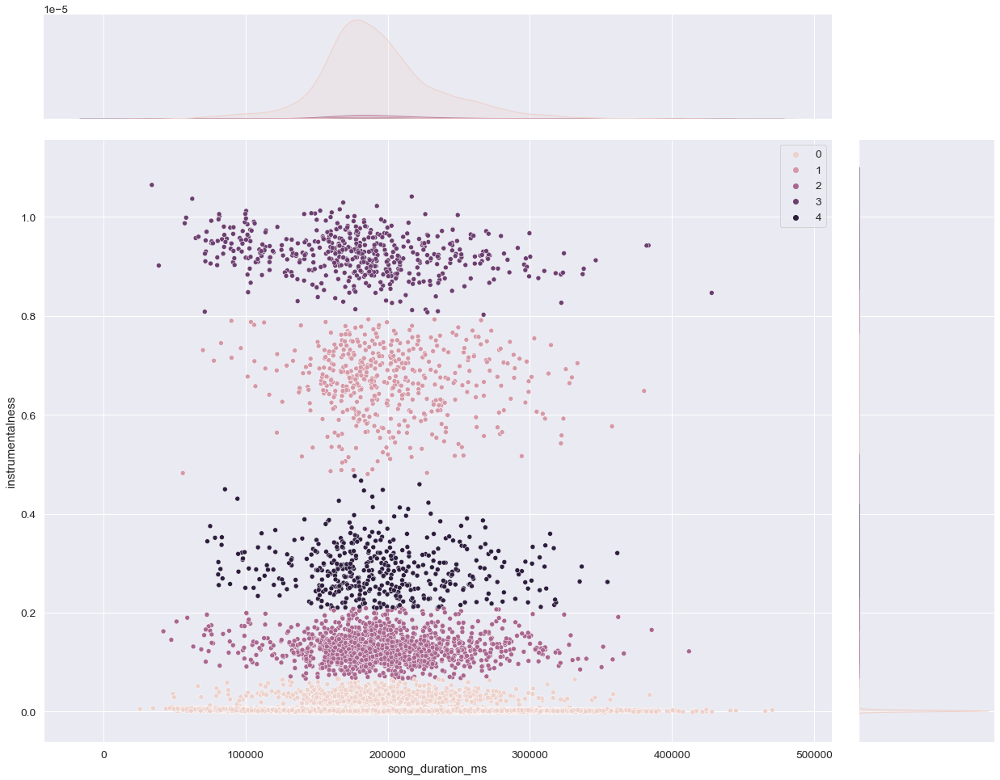

In [64]:
sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)
plt.savefig('../reports/figures/kmeans_clustering.png')
plt.show()

#### heirarchical clustering

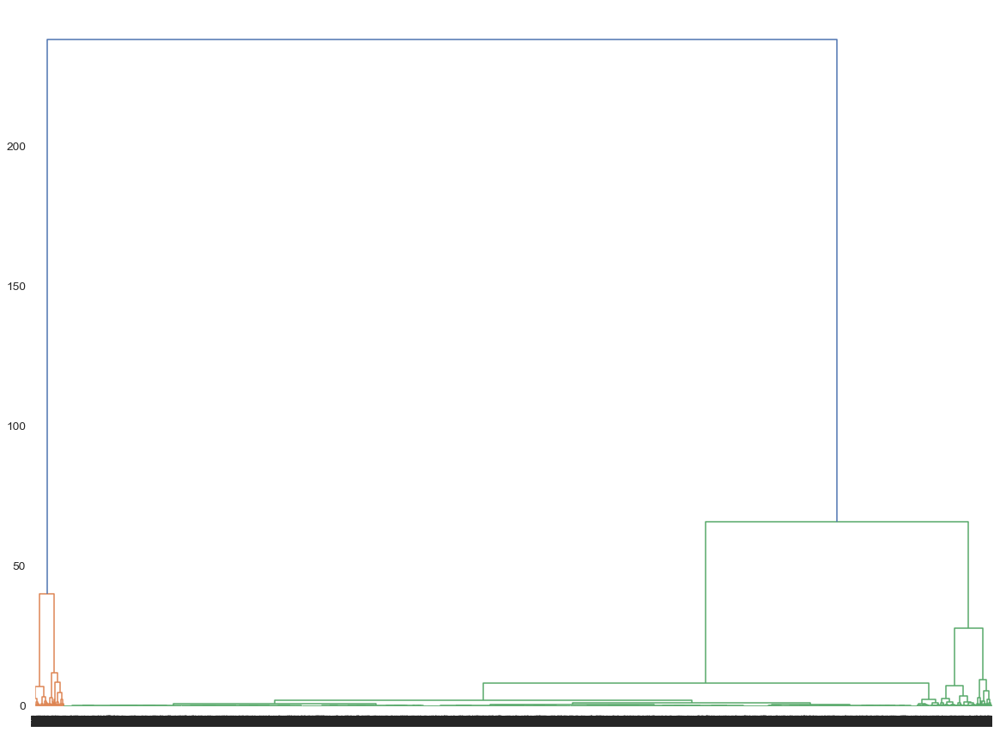

In [65]:
from scipy.cluster.hierarchy import dendrogram, linkage

# plot heirarchival cluster dendogram
Z = linkage(X_subset, 'ward')
dendrogram(Z, labels=train_knnimp.index, leaf_rotation=90)
plt.gcf().set_size_inches(20,15)
plt.savefig('../reports/figures/hierarchical_clustering.png')
plt.show()

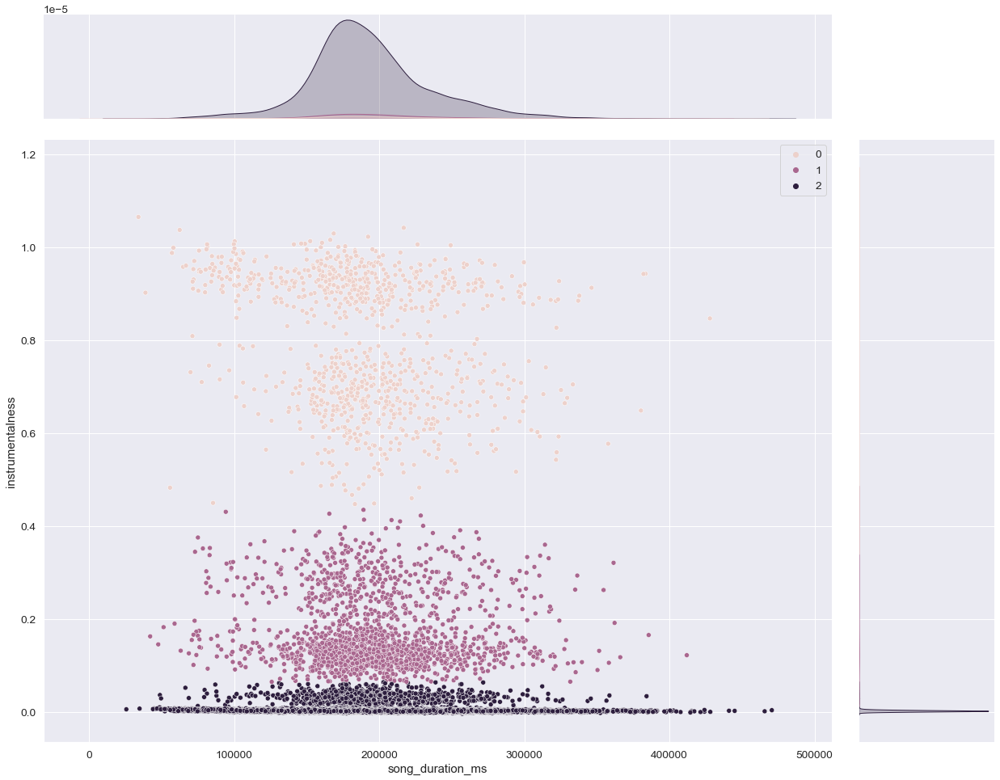

In [66]:
hc = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
labels = hc.fit_predict(X_subset)

sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)
plt.savefig('../reports/figures/agglomerative_clustering.png')
plt.show()

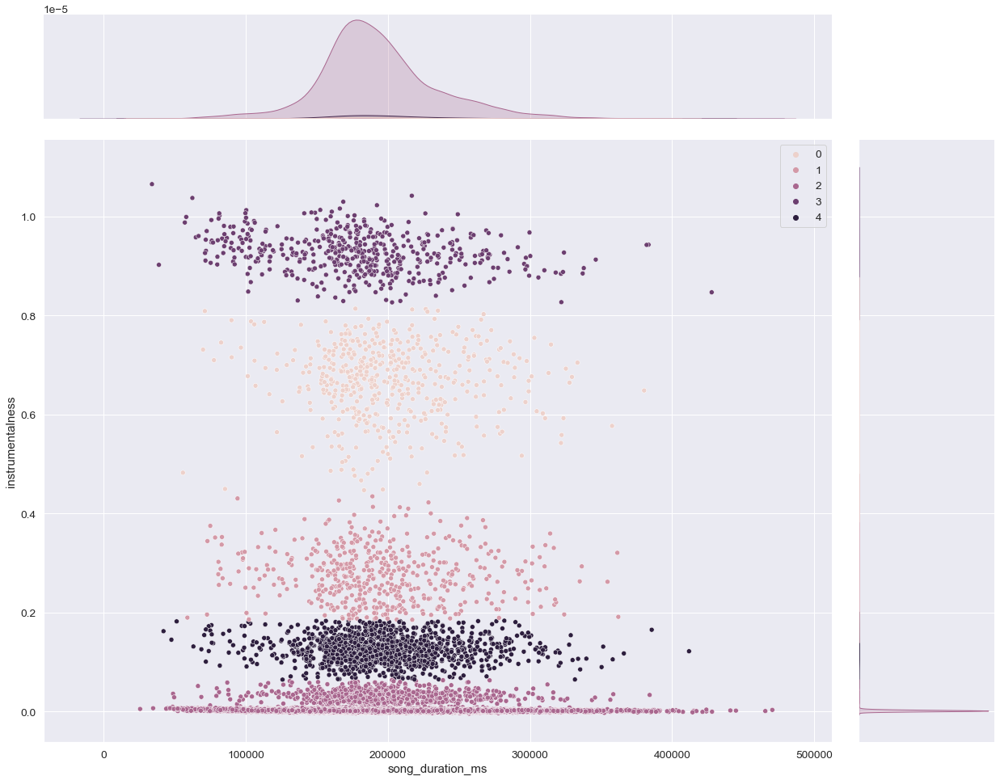

In [67]:
hc = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
labels = hc.fit_predict(X_subset)

sns.jointplot(data=train_knnimp, y='instrumentalness', x='song_duration_ms', hue=labels)
plt.gcf().set_size_inches(20,15)
plt.savefig('../reports/figures/agglomerative_clustering_5.png')

because knn clustering methode is computationally fast as well as being able to predict on new data, we'll use knn in our modeling

In [68]:
# for modeling
class Descretizer(BaseEstimator, TransformerMixin):
    def __init__(self, descritizer, variable, inplace=False, **kwrgs):
        self.variable = variable
        self.inplace = inplace
        self.descritizer = descritizer(**kwrgs)

    def fit(self, X, y=None):
        self.descritizer.fit(X[[self.variable]])
        
        return self


    def transform(self, X, y=None):
        if self.inplace:
            X[self.variable] = self.descritizer.predict(X[[self.variable]])
        else:
            X[self.variable+"_descrete"] = self.descritizer.predict(X[[self.variable]])

        return X

In [69]:
X_copy = train_knnimp.copy()

descretizer = Descretizer(KMeans, 'instrumentalness', True, n_clusters=5, random_state=0)
descretizer.fit(X_copy)
descretizer.transform(X_copy)

,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,...,time_signature,audio_valence,_song_duration_ms_imputed_,_acousticness_imputed_,_danceability_imputed_,_energy_imputed_,_instrumentalness_imputed_,_key_imputed_,_liveness_imputed_,_loudness_imputed_
0,249165.000000,0.018023,0.691292,0.782159,0,7.000000,0.253386,-4.446018,0.0,0.133197,...,4.0,0.291141,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,262839.000000,0.029204,0.296050,0.747173,0,0.000000,0.146838,-10.175356,1.0,0.331771,...,4.0,0.476756,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,249180.000000,0.231342,0.240227,0.981282,0,6.000000,0.111339,-7.609018,0.0,0.095754,...,3.0,0.226383,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,150192.000000,0.896027,0.290141,0.260367,0,10.000000,0.210436,-12.902434,0.0,0.039707,...,3.0,0.436087,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,169956.000000,0.606447,0.784803,0.662214,0,4.000000,0.353536,-7.492491,0.0,0.043732,...,3.0,0.343077,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31995,90620.000000,0.967651,0.253237,0.398236,0,2.000000,0.213360,-23.354092,0.0,0.031386,...,3.0,0.422895,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31996,211823.000000,0.583792,0.720222,0.628030,0,4.000000,0.133730,-12.502398,0.0,0.033433,...,3.0,0.612711,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31997,185251.790446,0.274205,0.782401,0.712629,0,9.000000,0.410477,-4.885842,0.0,0.055442,...,3.0,0.679638,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
31998,283988.000000,0.057312,0.365561,0.995350,0,7.000000,0.598332,-6.084404,0.0,0.280034,...,3.0,0.635851,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
